# KDD 2015

## Preliminaries

### Import Packages

In [ ]:
import sys
sys.path.append('..')
from utilities import * 

### Constants

In [2]:
# paths
PATH_TO_INTERACTION_DATA = '../../../../../../data/ddia/kdd_2015/complete/log_train.csv'
PATH_TO_ENROLLMENT_DATA = '../../../../../../data/ddia/kdd_2015/complete/enrollment_train.csv'
PATH_TO_DROPOUT_DATA = '../../../../../../data/ddia/kdd_2015/complete/truth_train.csv'
PATH_TO_OBJECT_DATA = '../../../../../../data/ddia/kdd_2015/ObjectData/object.csv'

# dataset name
DATASET_NAME = 'kdd_2015'

# fields used in the analysis
USER_FIELD = 'username'
GROUP_FIELD = 'course_id'
LEARNING_ACTIVITY_FIELD = 'object'
COURSE_FIELD = 'Course'
TIMESTAMP_FIELD = 'time'
ORDER_FIELD = None

# fields used in dataset preparation
ENROLLMENT_FIELD = 'enrollment_id'
DROPOUT_FIELD = 'is_dropout'
MODULE_FIELD = 'module_id'
EVENT_FIELD = 'event'
CATEGORY_FIELD = 'category'

# strings and values used in dataset preparation
VIDEO_VALUE_STR = 'video'
PROBLEM_VALUE_STR = 'problem'

# evaluation fields
# learning activity level
EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD = None
EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD = None
# group level
EVALUATION_GROUP_SCORE_FIELD = None
EVALUATION_GROUP_IS_CORRECT_FIELD = 'no_dropout' 
# course level
EVALUATION_COURSE_SCORE_FIELD = None
EVALUATION_COURSE_IS_CORRECT_FIELD = None 

# score threshold is correct
EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD = None
EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD = None
EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD = None

# evaluation min and max in dataset docu
EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU = None
EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU = None

# used for generating html tables
HTML_TABLES_DATA_LIST = [[LEARNING_ACTIVITY_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD, EVALUATION_LEARNING_ACTIVITY_IS_CORRECT_FIELD, EVALUATION_LEARNING_ACTIVITY_SCORE_CORRECT_THRESHOLD, EVALUATION_LEARNING_ACTIVITY_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_LEARNING_ACTIVITY_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [GROUP_FIELD, EVALUATION_GROUP_SCORE_FIELD, EVALUATION_GROUP_IS_CORRECT_FIELD, EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD, EVALUATION_GROUP_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_GROUP_SCORE_MAXIMUM_IN_DATASET_DOCU], 
                         [COURSE_FIELD, EVALUATION_COURSE_SCORE_FIELD, EVALUATION_COURSE_IS_CORRECT_FIELD, EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD, EVALUATION_COURSE_SCORE_MINIMUM_IN_DATASET_DOCU, EVALUATION_COURSE_SCORE_MAXIMUM_IN_DATASET_DOCU]]

### Import Pickled Objects

In [3]:
# seq_distances = pickle_read(PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
#                             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

# learning_activity_sequence_stats_per_group = pickle_read(PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
#                                                          DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

# html_table = pickle_read(PATH_TO_HTML_TABLES_PICKLE_FOLDER,
#                          DATASET_NAME + HTML_TABLES_PICKLE_NAME)

# cluster_eval = pickle_read(PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
#                            DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

### Functions

In [4]:
def calculate_eval_metrics(df: pd.DataFrame):
    """Calculate evaluation metrics per single learning_activity. This function should be used as input of the
    add_evaluation_fields function.

    Parameters
    ----------
    df : pd.DataFrame
        A subset of the interactions dataframe containing data of a single learning_activity

    Returns
    -------
    tuple
        A tuple of evaluation metric scalars per learning activity
    """
    df = df.copy()

    # number interactions
    number_interactions_total = df.shape[0]

    # number attempts (needs to be the same as interactions)
    number_attempts_total = df.shape[0]

    # number hints
    number_hints_total = None

    # total time
    time_total = None
        
    # scores
    # single score
    single_score = None
    # single score hint lowest 
    single_score_hint_lowest = None 
    # single score not first attempt lowest
    single_score_not_first_attempt_lowest = None
    # highest score
    score_highest = None
    # highest score without hint
    score_highest_without_hint = None
    # score first attempt
    score_first_attempt = None
    # score last attempt
    score_last_attempt = None
    # number interactions until highest score
    number_interactions_until_score_highest = None
    # number attempts until highest score
    number_attempts_until_score_highest = None
    # number hints until highest score
    number_hints_until_score_highest = None
    # time until highest score
    time_until_score_highest = None

    # corrects
    # correct
    is_correct = None
    # correct without hint
    is_correct_without_hint = None
    # correct first attempt
    is_correct_first_attempt = None
    # correct first attempt without hint
    is_correct_first_attempt_without_hint = None
    # correct last attempt
    is_correct_last_attempt = None
    # correct last attempt without hint
    is_correct_last_attempt_without_hint = None
    # number interactions until correct
    number_interactions_until_correct = None
    # number attempts until correct
    number_attempts_until_correct = None
    # number hints until correct
    number_hints_until_correct = None
    # time until correct
    time_until_correct = None

    return (number_interactions_total,
            number_attempts_total,
            number_hints_total,
            time_total,
            single_score,
            single_score_hint_lowest,
            single_score_not_first_attempt_lowest,
            score_highest,
            score_highest_without_hint,
            score_first_attempt,
            score_last_attempt,
            number_interactions_until_score_highest,
            number_attempts_until_score_highest,
            number_hints_until_score_highest,
            time_until_score_highest,
            is_correct,
            is_correct_without_hint,
            is_correct_first_attempt,
            is_correct_first_attempt_without_hint,
            is_correct_last_attempt,
            is_correct_last_attempt_without_hint,
            number_interactions_until_correct,
            number_attempts_until_correct,
            number_hints_until_correct,
            time_until_correct)

## Dataset Preparation

### Import Data

In [5]:
interactions = pd.read_csv(PATH_TO_INTERACTION_DATA)
enrollments = pd.read_csv(PATH_TO_ENROLLMENT_DATA)
dropouts = pd.read_csv(PATH_TO_DROPOUT_DATA, names=[ENROLLMENT_FIELD, DROPOUT_FIELD])
objects = pd.read_csv(PATH_TO_OBJECT_DATA) 

### Set Data Type

In [6]:
interactions = typecast_fields(interactions,
                               TIMESTAMP_FIELD,
                               None,
                               None,
                               LEARNING_ACTIVITY_FIELD)

enrollments = typecast_fields(enrollments,
                              None,
                              GROUP_FIELD,
                              USER_FIELD,
                              None)

### Merge and Filter Data

In [7]:
objects = objects[[MODULE_FIELD, CATEGORY_FIELD]].rename(columns={MODULE_FIELD: LEARNING_ACTIVITY_FIELD})
objects = objects.loc[~objects.duplicated(), :]

In [8]:
interactions = pd.merge(interactions, enrollments, how='inner', on=ENROLLMENT_FIELD)
interactions = pd.merge(interactions, dropouts, how='inner', on=ENROLLMENT_FIELD)
interactions = interactions.merge(objects, how='left', on=LEARNING_ACTIVITY_FIELD)

In [9]:
interactions

,enrollment_id,time,source,event,object,username,course_id,is_dropout,category
0,1,2014-06-14 09:38:29,server,navigate,Oj6eQgzrdqBMlaCtaq1IkY6zruSrb71b,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,NaN
1,1,2014-06-14 09:38:39,server,access,3T6XwoiMKgol57cm29Rjy8FXVFcIomxl,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,NaN
2,1,2014-06-14 09:38:39,server,access,qxvBNYTfiRkNcCvM0hcGwG6hvHdQwnd4,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
3,1,2014-06-14 09:38:48,server,access,2cmZrZW2h6Il91itO3e89FGcABLWhf3W,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
4,1,2014-06-14 09:41:49,browser,problem,RMtgC2bTAqEeftenUUyia504wsyzeZWf,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,problem
...,...,...,...,...,...,...,...,...,...
8157272,200901,2014-07-24 14:11:31,browser,page_close,3T6XwoiMKgol57cm29Rjy8FXVFcIomxl,PPEydg4GXh52QanXuUYKbv8ENUSViBbd,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,NaN
8157273,200901,2014-07-24 14:11:32,browser,video,HdMvr3A6vQzym6Xl0tOXpNbfHOyohlKE,PPEydg4GXh52QanXuUYKbv8ENUSViBbd,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,video
8157274,200901,2014-07-24 14:11:41,browser,page_close,3T6XwoiMKgol57cm29Rjy8FXVFcIomxl,PPEydg4GXh52QanXuUYKbv8ENUSViBbd,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,NaN
8157275,200904,2014-07-24 15:07:50,server,navigate,9Mur5ciTV9IBFfcPaz5c3nC1lrZaxBvG,7k4xZXZirLFjbh80SpWNqJdTubgGglfv,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,NaN


In [10]:
interactions.category.value_counts()

sequential           2235199
problem              1187613
video                 637949
chapter               324319
combinedopenended         93
Name: category, dtype: int64

In [11]:
interactions.category.nunique()

5

In [12]:
test = interactions.loc[interactions.category=='sequential', :]
test

,enrollment_id,time,source,event,object,username,course_id,is_dropout,category
2,1,2014-06-14 09:38:39,server,access,qxvBNYTfiRkNcCvM0hcGwG6hvHdQwnd4,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
3,1,2014-06-14 09:38:48,server,access,2cmZrZW2h6Il91itO3e89FGcABLWhf3W,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
16,1,2014-06-19 06:21:32,server,access,qxvBNYTfiRkNcCvM0hcGwG6hvHdQwnd4,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
18,1,2014-06-19 06:21:45,server,access,0OkCwDvaJhsSkoN6yuhvnxMAJXu8tx6G,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
20,1,2014-06-19 06:22:12,server,access,2cmZrZW2h6Il91itO3e89FGcABLWhf3W,9Uee7oEuuMmgPx2IzPfFkWgkHZyPbWr0,DPnLzkJJqOOPRJfBxIHbQEERiYHu5ila,0,sequential
...,...,...,...,...,...,...,...,...,...
8157244,200887,2014-07-24 03:28:05,server,access,jcmKbpHQYLyzZZ34cJgLu7F4pgiCsoXV,rmuVWK4wDaWBF68nCTNrZ4o95Q47TDNk,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,sequential
8157245,200887,2014-07-24 03:28:09,server,access,jcmKbpHQYLyzZZ34cJgLu7F4pgiCsoXV,rmuVWK4wDaWBF68nCTNrZ4o95Q47TDNk,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,sequential
8157256,200888,2014-07-24 03:48:14,server,access,jcmKbpHQYLyzZZ34cJgLu7F4pgiCsoXV,8r1wO8douiG9wPFG7rg5WG5F0cpQdW2l,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,sequential
8157270,200901,2014-07-24 14:07:55,server,access,jcmKbpHQYLyzZZ34cJgLu7F4pgiCsoXV,PPEydg4GXh52QanXuUYKbv8ENUSViBbd,9zpXzW9zCfU8KGBWkhlsGH8B8czISH4J,1,sequential


In [13]:
test.event.value_counts()

access    2235199
Name: event, dtype: int64

In [14]:
interactions = interactions.copy().query(f"{EVENT_FIELD}=='{PROBLEM_VALUE_STR}' or {EVENT_FIELD}=='{VIDEO_VALUE_STR}'")

### Transform Categorical Variable Values

In [15]:
interactions, value_mapping_df = map_new_to_old_values(interactions, 
                                                       GROUP_FIELD, 
                                                       USER_FIELD, 
                                                       LEARNING_ACTIVITY_FIELD)

### Filter Sequences by NAs in Dataset 

In [16]:
pct_na = get_nas_in_data(interactions)

enrollment_id                   0.0 %
time                            0.0 %
source                          0.0 %
event                           0.0 %
object                          0.0 %
username                        0.0 %
course_id                       0.0 %
is_dropout                      0.0 %
category         11.295361610162244 %
dtype: object

In [17]:
interactions, na_indices_list = drop_learning_activity_sequence_if_contains_na_in_field(interactions, 
                                                                                        GROUP_FIELD, 
                                                                                        USER_FIELD, 
                                                                                        field_list=[TIMESTAMP_FIELD,
                                                                                                    LEARNING_ACTIVITY_FIELD,
                                                                                                    DROPOUT_FIELD], 
                                                                                        field_value_tuple_filter_list=[])



Input length: 2058128
Outpunt length: 2058128
Number of rows removed: 0
Percentage of rows removed: 0.0%
--------------------------------------------------
Input number of sequences: 79870
Output number of sequences: 79870
Number of sequences removed: 0
Percentage of sequences removed: 0.0%


In [18]:
interactions = drop_na_by_fields(interactions,
                                 field_list=[GROUP_FIELD,
                                             USER_FIELD])

Input length: 2058128
Outpunt length: 2058128
Number of rows removed: 0
Percentage of rows removed: 0%


In [19]:
pct_na = get_nas_in_data(interactions)

enrollment_id                   0.0 %
time                            0.0 %
source                          0.0 %
event                           0.0 %
object                          0.0 %
username                        0.0 %
course_id                       0.0 %
is_dropout                      0.0 %
category         11.295361610162244 %
dtype: object

### Sort by Timestamp

In [20]:
interactions = sort_by_timestamp(interactions,
                                 GROUP_FIELD,
                                 USER_FIELD,
                                 TIMESTAMP_FIELD,
                                 ORDER_FIELD)

### Evaluation Score Fields Ranges

In [21]:
evaluation_score_range_dict = return_and_plot_evaluation_score_range(interactions,
                                                                     LEARNING_ACTIVITY_FIELD,
                                                                     EVALUATION_LEARNING_ACTIVITY_SCORE_FIELD,
                                                                     GROUP_FIELD,
                                                                     EVALUATION_GROUP_SCORE_FIELD,
                                                                     EVALUATION_COURSE_SCORE_FIELD)

### Transform Data

In [22]:
interactions[EVALUATION_GROUP_IS_CORRECT_FIELD] = interactions[DROPOUT_FIELD].map({0: True, 1: False})

#### Add Evaluation Fields

In [23]:
interactions = add_evaluation_fields(interactions,
                                     GROUP_FIELD,
                                     USER_FIELD,
                                     LEARNING_ACTIVITY_FIELD,
                                     TIMESTAMP_FIELD,
                                     None,
                                     np.mean,
                                     EVALUATION_GROUP_SCORE_FIELD,
                                     EVALUATION_GROUP_IS_CORRECT_FIELD,
                                     EVALUATION_COURSE_SCORE_FIELD,
                                     EVALUATION_COURSE_IS_CORRECT_FIELD,
                                     False,
                                     False,
                                     EVALUATION_GROUP_SCORE_CORRECT_THRESHOLD,
                                     EVALUATION_COURSE_SCORE_CORRECT_THRESHOLD,
                                     operator.gt,
                                     operator.gt,
                                     calculate_eval_metrics)

100%|██████████| 79870/79870 [00:03<00:00, 24993.80it/s]


= Repeated Interactions Removal =
Initial number of interactions: 2058128
Final number of interactions: 1016073
Removed number of interactions: 1042055
Removed percentage of interactions: 50.63120466754254%


### Rename Fields

In [24]:
interactions, fields_mapping_df = rename_fields(interactions,
                                                GROUP_FIELD,
                                                USER_FIELD,
                                                LEARNING_ACTIVITY_FIELD,
                                                TIMESTAMP_FIELD)

### Add Sequence ID Field

In [25]:
interactions = add_sequence_id_field(interactions,
                                     GROUP_FIELD)

### Check Dataset

In [26]:
interactions.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1016073 entries, 0 to 1016072
Data columns (total 86 columns):
 #   Column                                                                                   Non-Null Count    Dtype         
---  ------                                                                                   --------------    -----         
 0   Timestamp                                                                                1016073 non-null  datetime64[ns]
 1   User                                                                                     1016073 non-null  object        
 2   Topic                                                                                    1016073 non-null  object        
 3   Learning Resource                                                                        1016073 non-null  object        
 4   Sequence ID                                                                              1016073 non-null  object       

In [27]:
pct_na = get_nas_in_data(interactions)
pct_na

Timestamp                                                                                    0.0 %
User                                                                                         0.0 %
Topic                                                                                        0.0 %
Learning Resource                                                                            0.0 %
Sequence ID                                                                                  0.0 %
Learning Resource Interactions Total                                                         0.0 %
Learning Resource Attempts Total                                                             0.0 %
Learning Resource Hints Total                                                              100.0 %
Learning Resource Time in Seconds Total                                                    100.0 %
Learning Resource Single Score                                                             100.0 %
Learning R

### Create HtmlTables Dataset Info Object

In [28]:
html_table = HtmlTables(DATASET_NAME,
                        interactions, 
                        evaluation_score_range_dict, 
                        HTML_TABLES_DATA_LIST)

### Save the Dataset, Mapping Information and HtmlTables Object 

In [29]:
save_interaction_and_mapping_df(interactions,
                                fields_mapping_df,
                                value_mapping_df,
                                PATH_TO_CLEANED_DATASETS,
                                DATASET_NAME)

In [30]:
pickle_write(html_table,
             PATH_TO_HTML_TABLES_PICKLE_FOLDER,
             DATASET_NAME + HTML_TABLES_PICKLE_NAME)

## Dataset Characteristics

### Dataset Information

---
**Has GROUPING Field:** True

---
**Available Evaluation Metrics**  
Possible Values: 
>- True 
>- False
>- Derived (For 'Is Correct' fields)

Score Threshold to be correct:   
>    Learning Activity Is Correct Threshold:  
>    Group Is Correct Threshold:  
>    Course Is Correct Threshold:  

>**I. Learning Activity Level**:

- **Number of Interactions Total:**

- **Number of Attempts Total:**

- **Number of Hints Total:**

- **Score Highest:**

- **Score Highest without Hint:**

- **Score First Attempt:**

- **Score Last Attempt:**

- **Number of Interactions until Highest Score:**

- **Number of Attempts until Highest Score:**

- **Number of Hints until Highest Score:**

- **Is Correct:** Derived
        
- **Is Correct without Hint:**

- **Is Correct at First Attempt:**

- **Is Correct at First Attempt without Hint:**
        
- **Is Correct at Last Attempt :**

- **Is Correct at Last Attempt without Hint:**

- **Number of Interactions until Correct:**

- **Number of Attempts until Correct:**

- **Number of Hints until Correct:**


>**II. Group level**:

- **Group Score:**

- **Group Is Correct:**


>**III. Course level**:

- **Course Score:** True  
Final grades of course

- **Course Is Correct:** False

---
**Additional Information:**

- Objects.csv containt information about object hierarchy -> worth taking a closer look into it

- Evaluations are approximated by dropouts

- Focus on certain events: problems, videos(maybe)

### Available Fields

In [31]:
html_table.display_available_fields()

<table border="1" class="dataframe">
  <thead>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center"> </th>
      <th style = "background-color: royalblue; color: white; text-align:center">Is Available</th>
    </tr>
    <tr>
      <th style = "background-color: royalblue; color: white; text-align:center">Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">kdd_2015</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Timestamp</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">User</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Sequence ID</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Total</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Total</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Total</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Hint Taken Equals Lowest Score)</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Single Score (Not First Attempt Equals Lowest Score)</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Highest Score Without Hint</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Highest Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource First Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Last Attempt Is Correct Without Hints</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Interactions Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Attempts Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Hints Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Learning Resource Time in Seconds Until Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Topic Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Total All Learning Resources Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Total All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Hint Taken Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Single Score (Not First Attempt Equals Lowest Score) All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Highest Score Without Hint All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Highest Score All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course First Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Last Attempt Is Correct Without Hints All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Interactions Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Attempts Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Hints Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Time in Seconds Until Correct All Learning Resources Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Score All Topics Mean</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
    </tr>
    <tr>
      <td style = "background-color: rgb(80, 80, 80); color: white">Course Is Correct All Topics Mean</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
    </tr>
  </tbody>
</table>

### Score - Is_Correct Relationship

In [32]:
html_table.display_score_is_correct_relationship()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Score Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Has Is_Correct Field</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Chosen Score Is_Correct Threshold</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum In Documentation</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data Identical Over Evaluation Elements</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Minimum in Data</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Score Maximum in Data</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th rowspan="3" valign="top" style = "background-color: rgb(80, 80, 80); color: white">kdd_2015</th>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Learning Resource</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Topic</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">Course</th>
      <td style = "background-color: green; color: white; text-align:center">True</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "background-color: red; color: white; text-align:center">False</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
      <td style = "text-align:center">-</td>
    </tr>
  </tbody>
</table>

### Summary Statistics

In [33]:
html_table.display_summary_statistics()

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th style = "background-color: royalblue; color: white; text-align:center"></th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Interactions</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Users</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Topics</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Learning Resources</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center"># of Unique Sequences</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Learning Resource Matrix %</th>
      <th style = "background-color: royalblue; color: white; text-align:center">Sparsity User-Topic Matrix %</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th style = "background-color: rgb(80, 80, 80); color: white; text-align:center">kdd_2015</th>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">1016073</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">57747</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">39</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">4158</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">79870</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">39187</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">99.68</td>
      <td style = "background-color: rgb(0, 0, 204); color: white; text-align:center">96.45</td>
    </tr>
  </tbody>
</table>

### Group-User-Learning_Activity Relationship

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Interactions per User:
----------------------------------------------------------------------------------------------------
mean: number of interactions per User: 17.595251701387085
median: number of interactions per User: 5.0
max: number of interactions per User: 895
min: number of interactions per User: 1
std: number of interactions per User: 35.69886133313802
iqr: number of interactions per User: 16.0


Plots:


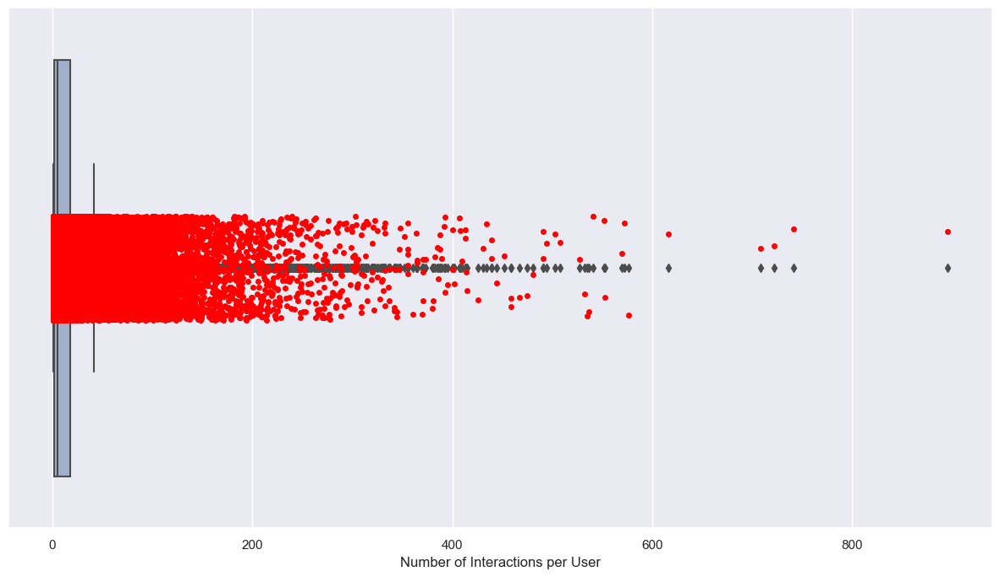

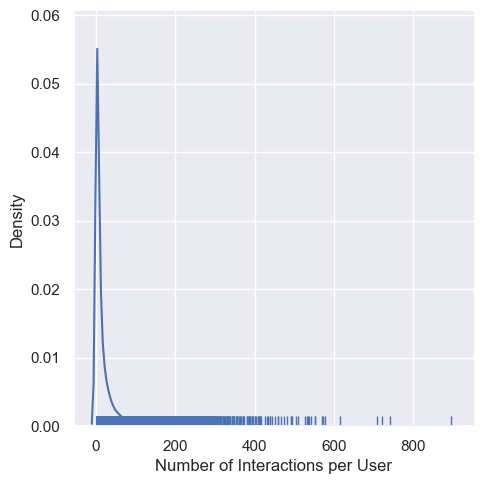

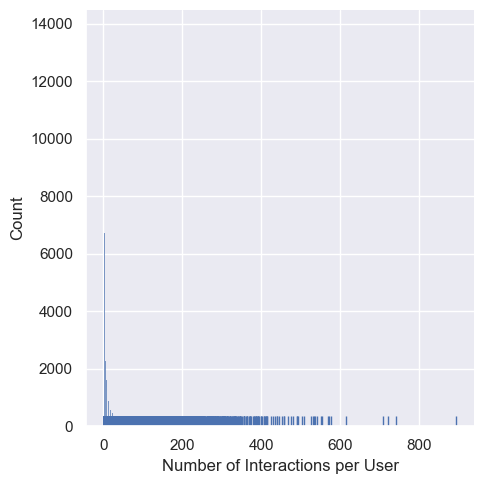

****************************************************************************************************
****************************************************************************************************
----------------------------------------------------------------------------------------------------
Number of Unique Topics per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per User: 1.3831021524927702
median: Number of Unique Topics per User: 1.0
max: Number of Unique Topics per User: 23
min: Number of Unique Topics per User: 1
std: Number of Unique Topics per User: 0.949105154154426
iqr: Number of Unique Topics per User: 0.0


Plots:


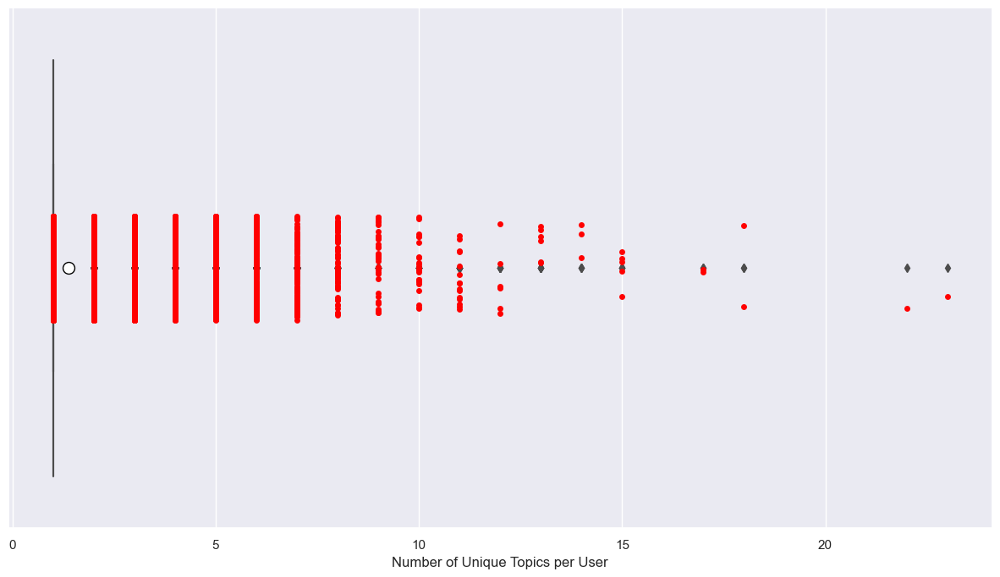

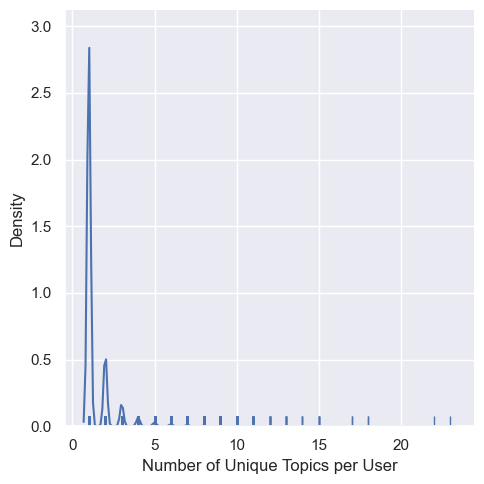

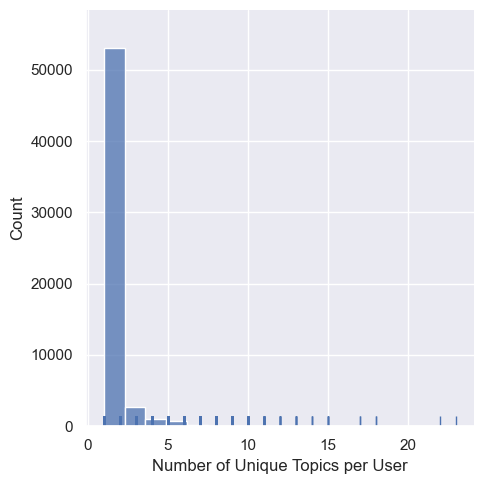

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per User:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per User: 13.298058773615946
median: Number of Unique Learning Resources per User: 4.0
max: Number of Unique Learning Resources per User: 550
min: Number of Unique Learning Resources per User: 1
std: Number of Unique Learning Resources per User: 25.533916239854914
iqr: Number of Unique Learning Resources per User: 12.0


Plots:


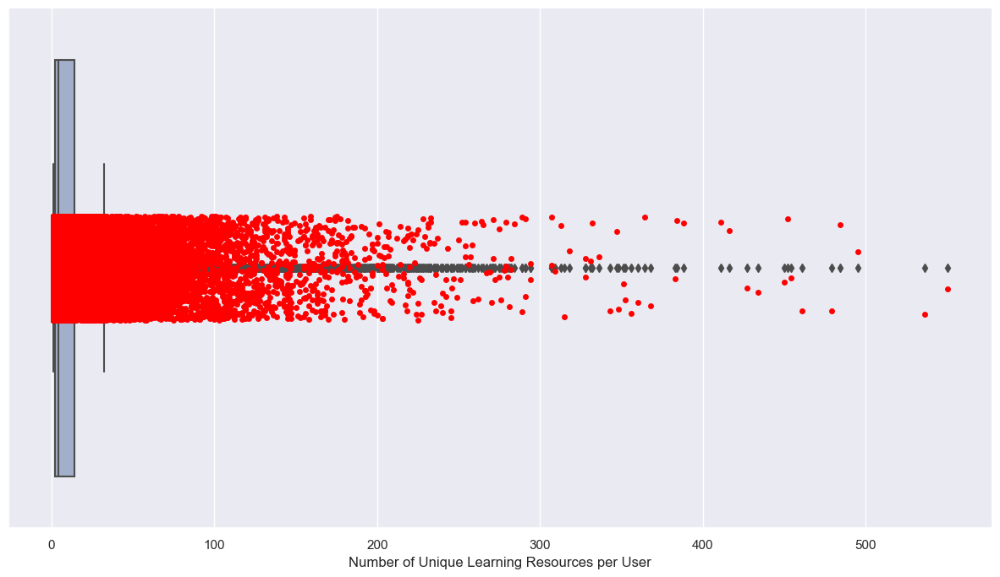

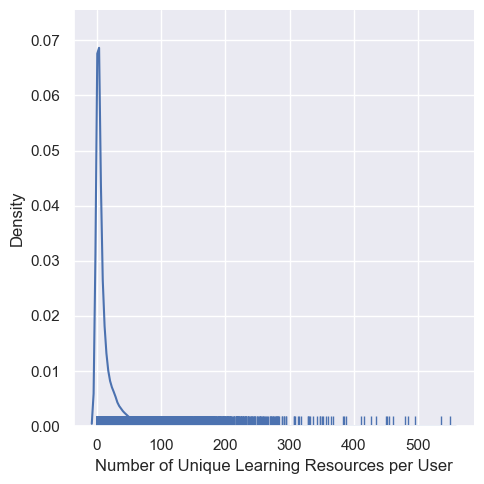

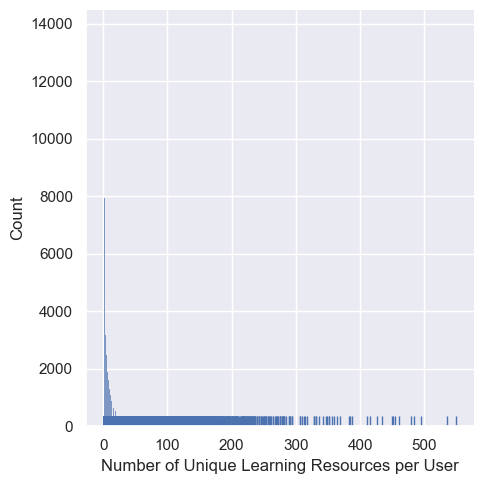

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Topic: 2047.948717948718
median: Number of Unique Users per Topic: 1395.0
max: Number of Unique Users per Topic: 9365
min: Number of Unique Users per Topic: 269
std: Number of Unique Users per Topic: 2151.8415118306893
iqr: Number of Unique Users per Topic: 1401.0


Plots:


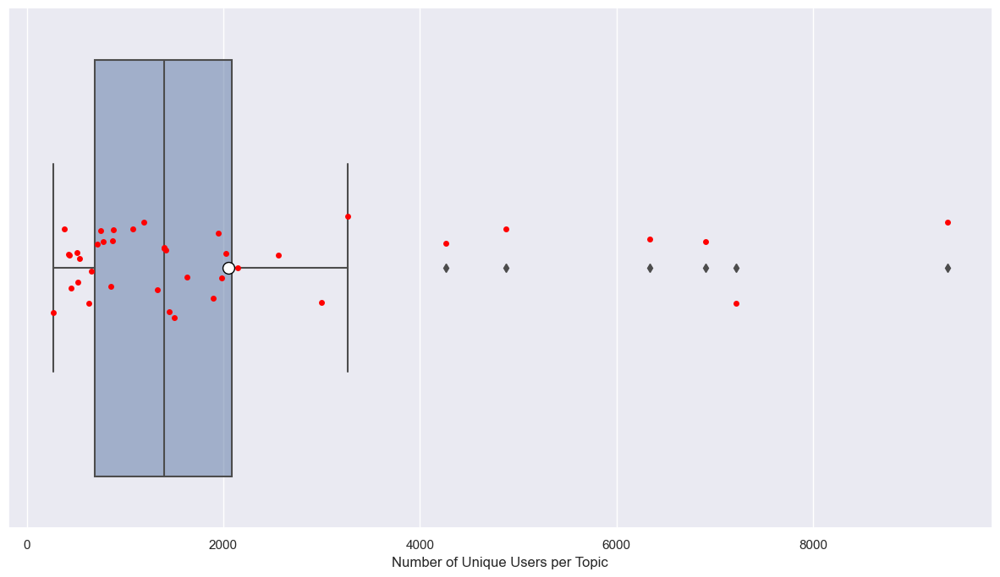

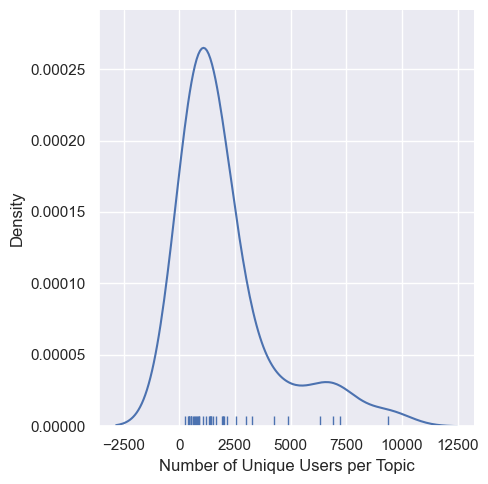

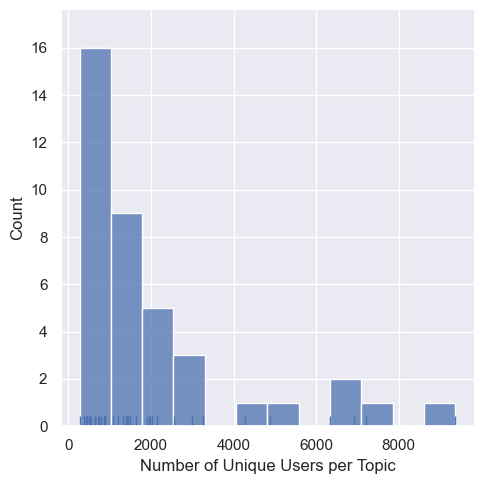

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Learning Resources per Topic:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Learning Resources per Topic: 107.58974358974359
median: Number of Unique Learning Resources per Topic: 79.0
max: Number of Unique Learning Resources per Topic: 303
min: Number of Unique Learning Resources per Topic: 25
std: Number of Unique Learning Resources per Topic: 73.48960468869693
iqr: Number of Unique Learning Resources per Topic: 94.0


Plots:


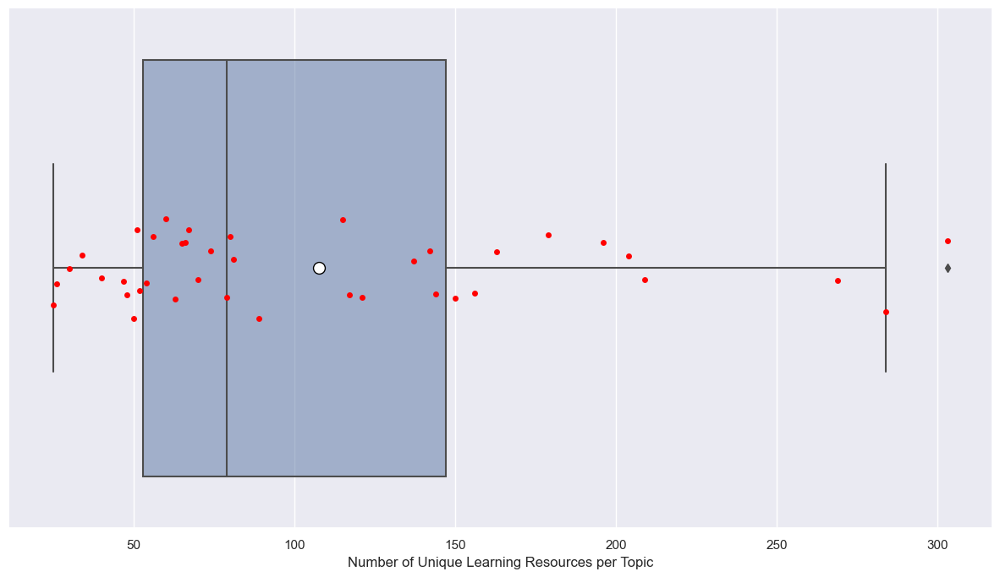

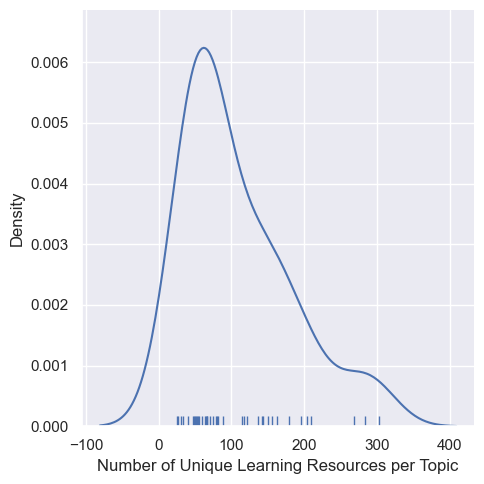

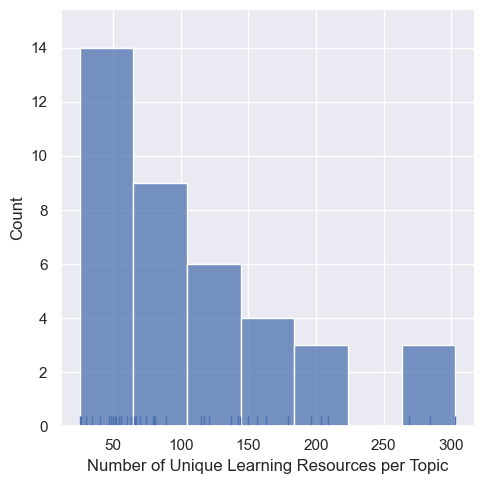

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Users per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Users per Learning Resource: 184.68566618566618
median: Number of Unique Users per Learning Resource: 55.0
max: Number of Unique Users per Learning Resource: 14728
min: Number of Unique Users per Learning Resource: 1
std: Number of Unique Users per Learning Resource: 474.5139295834278
iqr: Number of Unique Users per Learning Resource: 151.0


Plots:


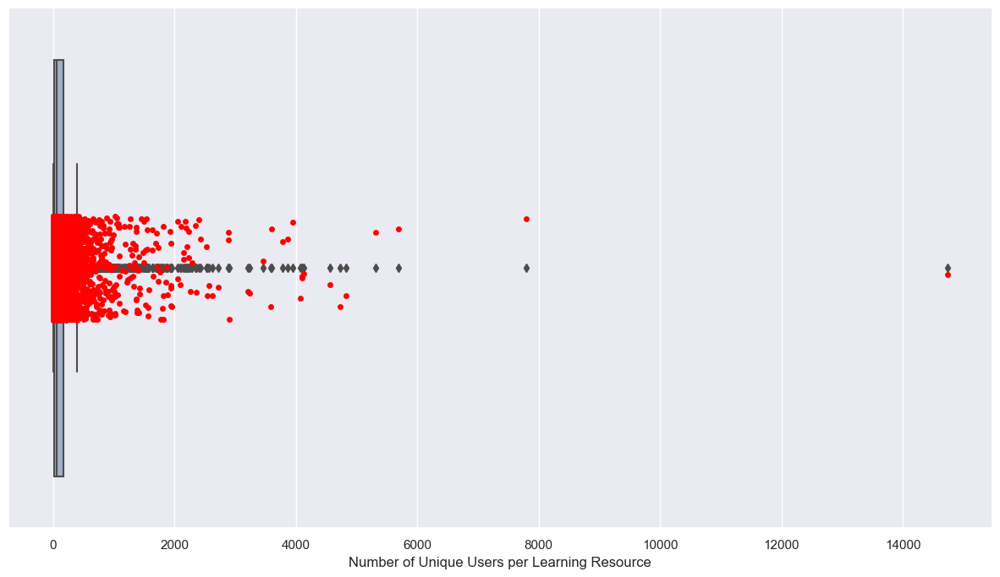

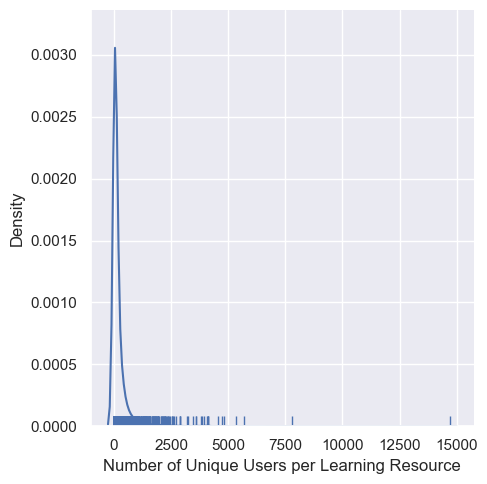

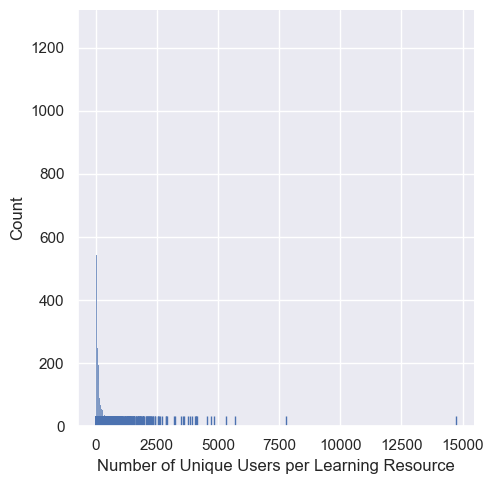

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Topics per Learning Resource:
----------------------------------------------------------------------------------------------------
mean: Number of Unique Topics per Learning Resource: 1.0091390091390091
median: Number of Unique Topics per Learning Resource: 1.0
max: Number of Unique Topics per Learning Resource: 39
min: Number of Unique Topics per Learning Resource: 1
std: Number of Unique Topics per Learning Resource: 0.5893066665856816
iqr: Number of Unique Topics per Learning Resource: 0.0


Plots:


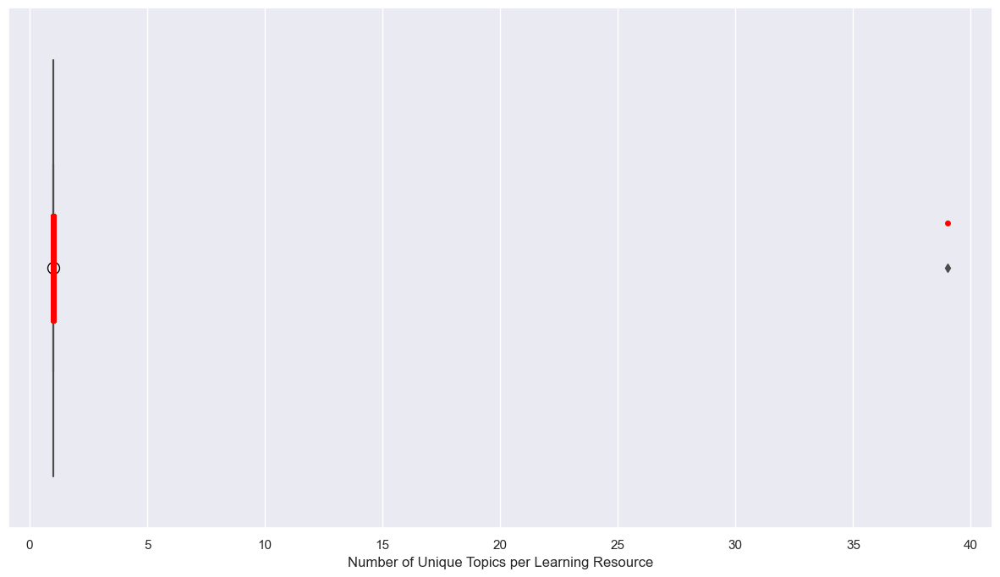

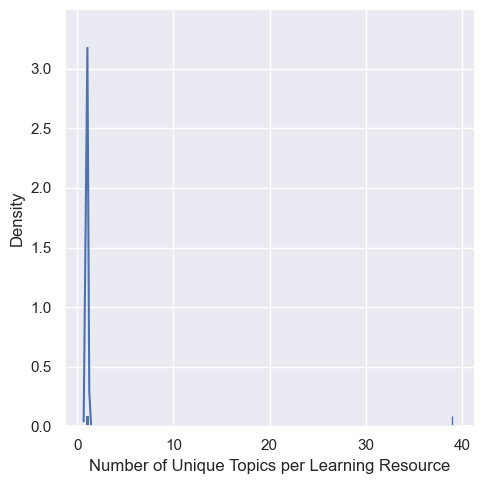

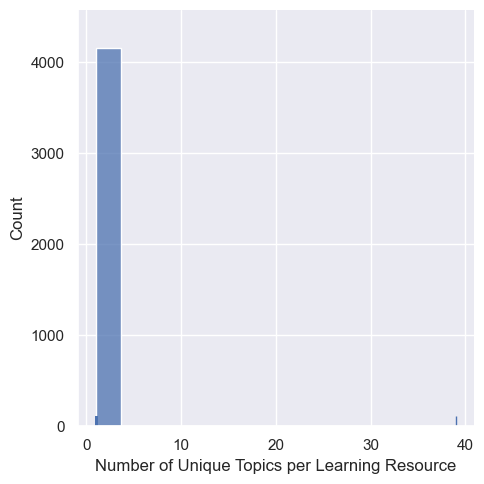

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per Topic for a User: 11.445304725112615
median of Mean Number of Interactions per Topic for a User: 4.0
max of Mean Number of Interactions per Topic for a User: 434.0
min of Mean Number of Interactions per Topic for a User: 1.0
std of Mean Number of Interactions per Topic for a User: 19.594118401926426
iqr of Mean Number of Interactions per Topic for a User: 11.5

____________________________________________________________________________________________________

mean of Median Number of Intera

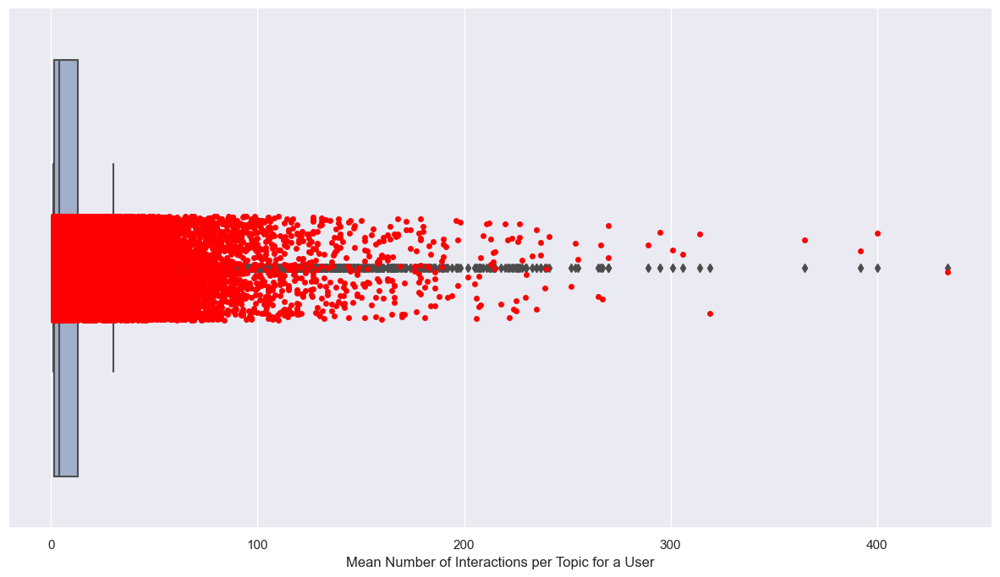

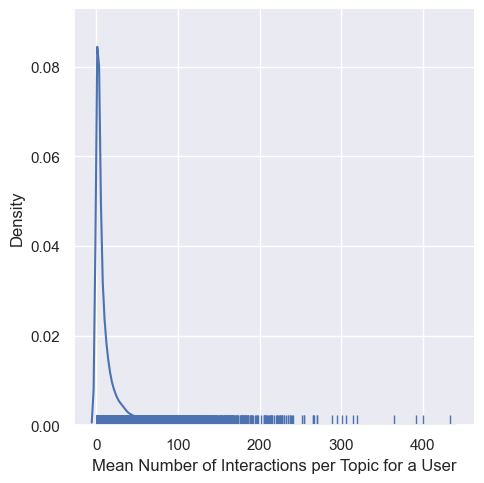

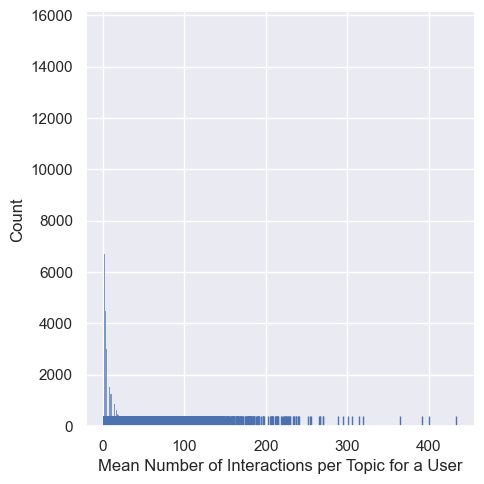



Median:


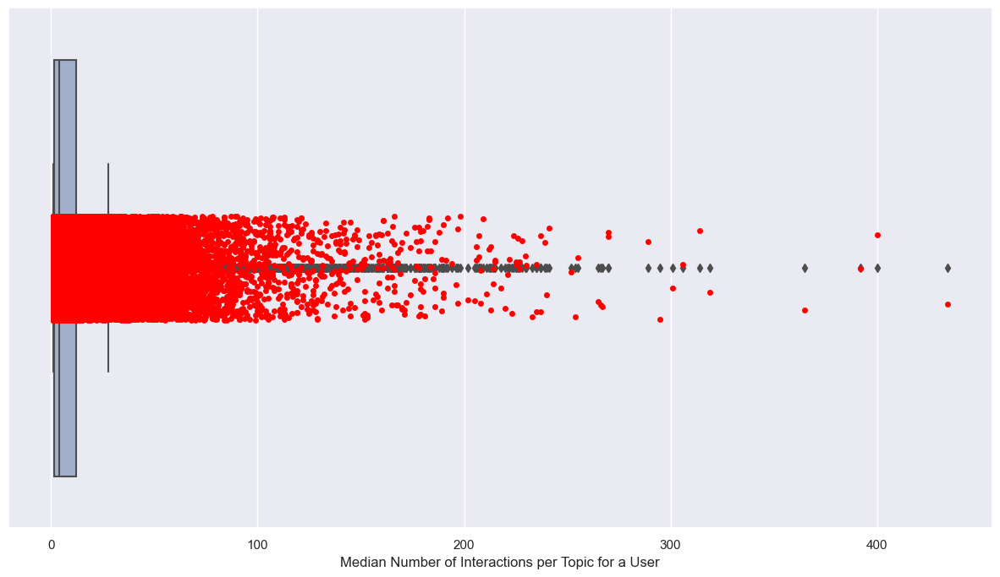

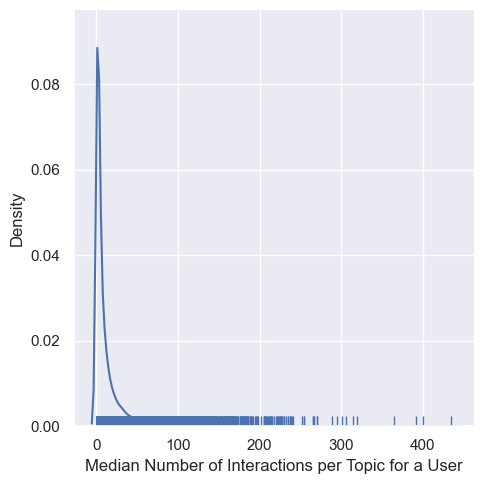

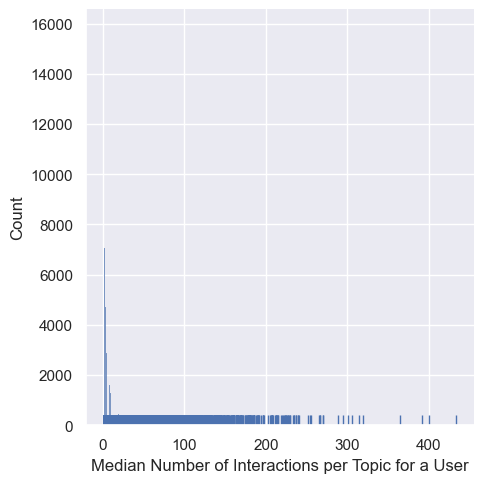

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Interactions per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Interactions per User for a Topic: 14.315796897545905
median of Mean Number of Interactions per User for a Topic: 12.308550185873607
max of Mean Number of Interactions per User for a Topic: 31.16308040770102
min of Mean Number of Interactions per User for a Topic: 4.381226053639847
std of Mean Number of Interactions per User for a Topic: 7.311743434388223
iqr of Mean Number of Interactions per User for a Topic: 11.807812954047318

_______________________________________________________________________________

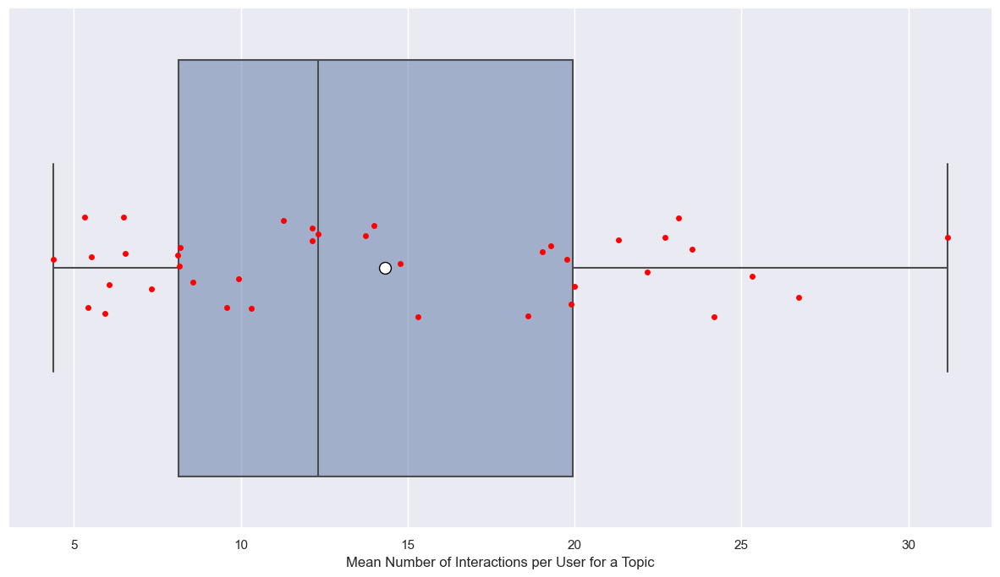

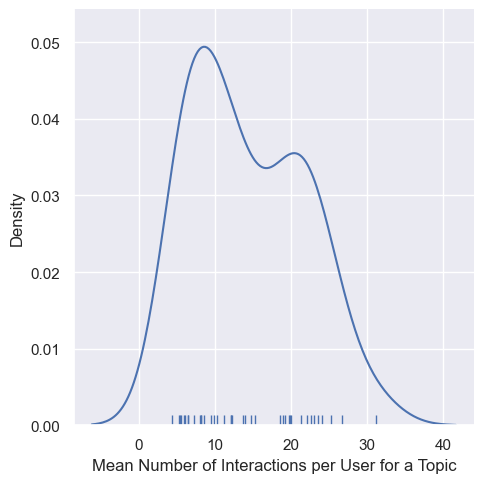

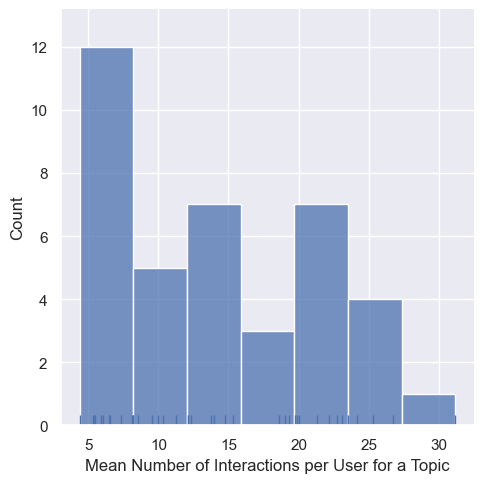



Median:


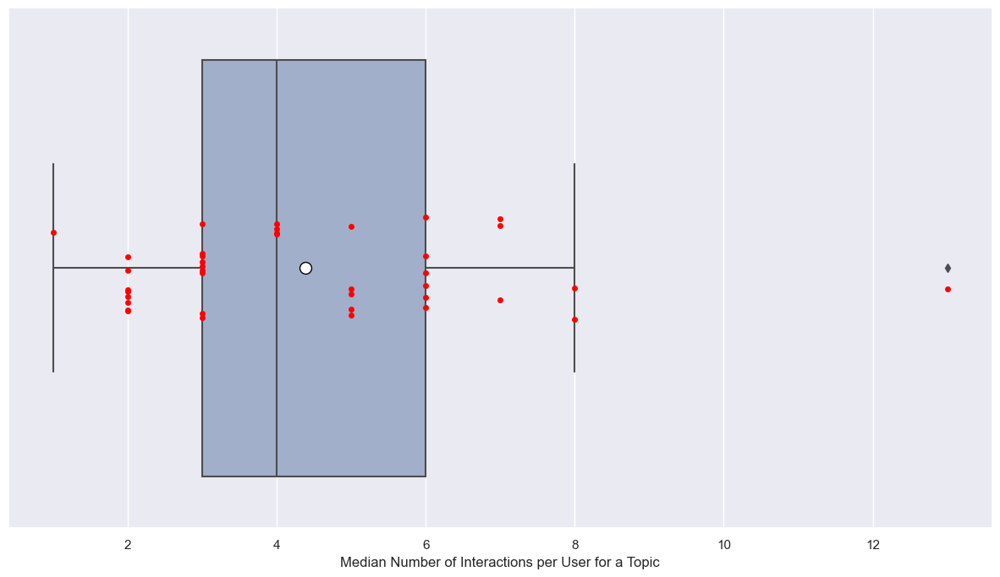

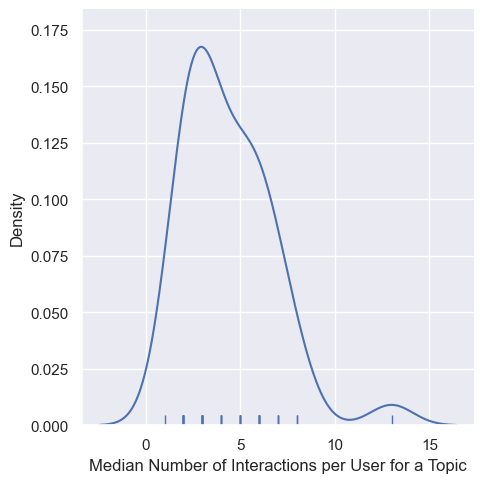

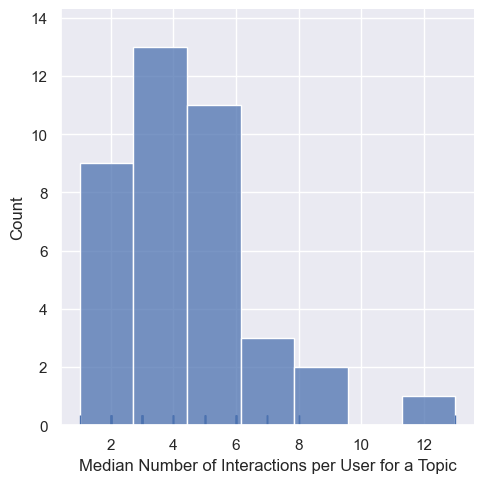

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per Topic for a User:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per Topic for a User: 8.706286236293279
median of Mean Number of Unique Learning Resources per Topic for a User: 4.0
max of Mean Number of Unique Learning Resources per Topic for a User: 272.0
min of Mean Number of Unique Learning Resources per Topic for a User: 1.0

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per Topic for a User: 8.415865759260221
median of Medi

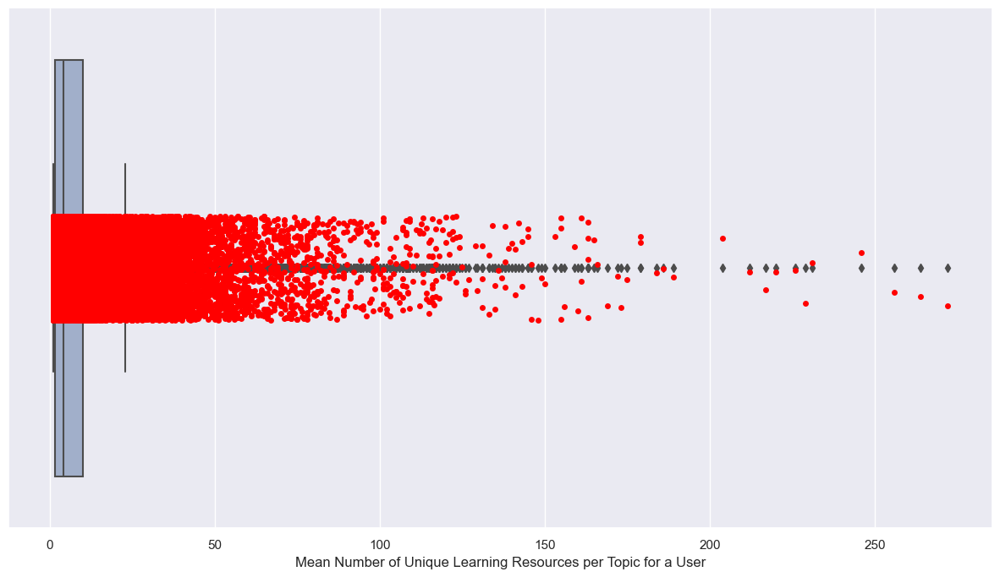

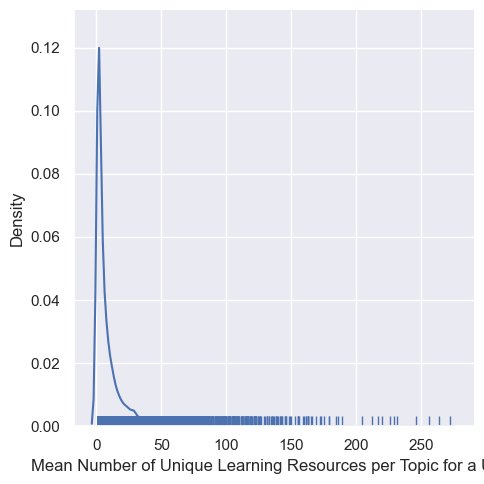

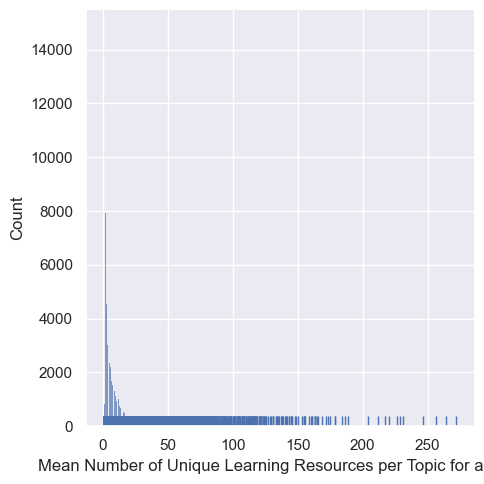



Median:


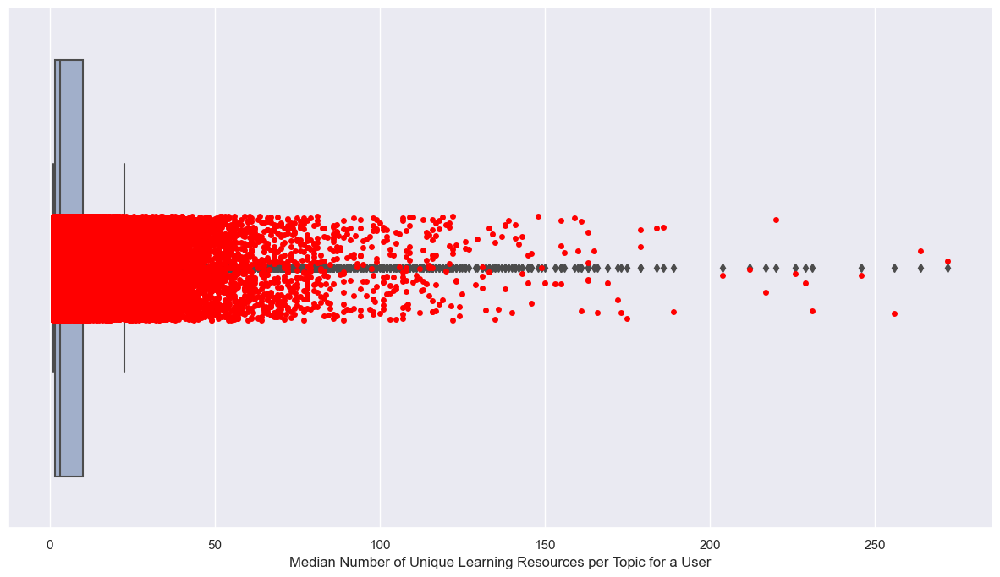

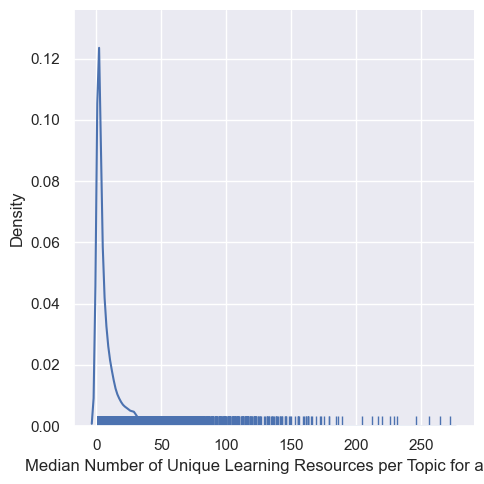

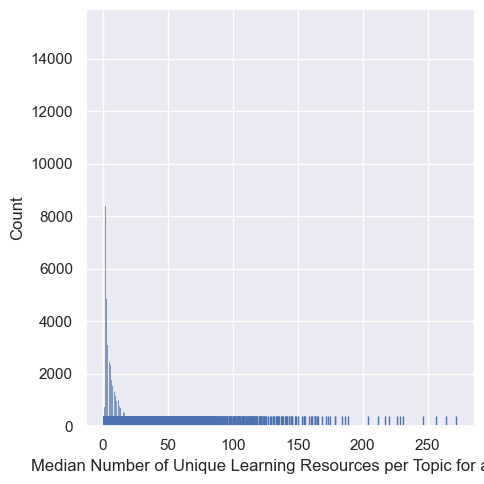

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean/Median Number of Unique Learning Resources per User for a Topic:
----------------------------------------------------------------------------------------------------
mean of Mean Number of Unique Learning Resources per User for a Topic: 10.778288169696387
median of Mean Number of Unique Learning Resources per User for a Topic: 9.840148698884759
max of Mean Number of Unique Learning Resources per User for a Topic: 23.246885617214044
min of Mean Number of Unique Learning Resources per User for a Topic: 3.7375478927203063

____________________________________________________________________________________________________

mean of Median Number of Unique Learning Resources per User fo

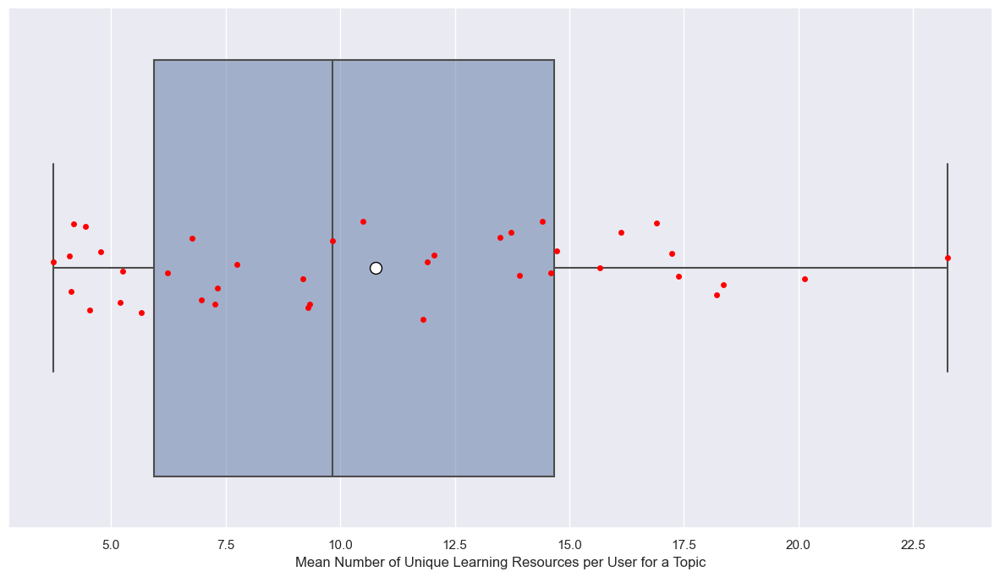

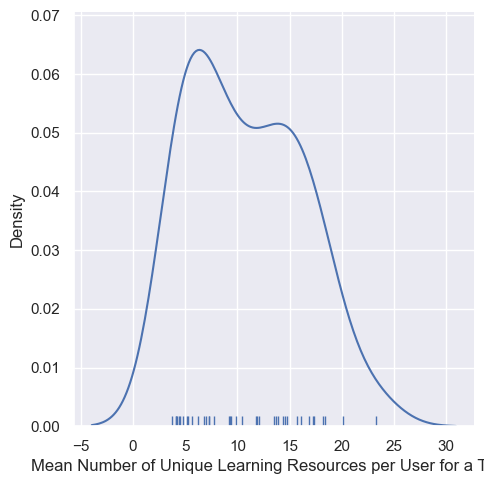

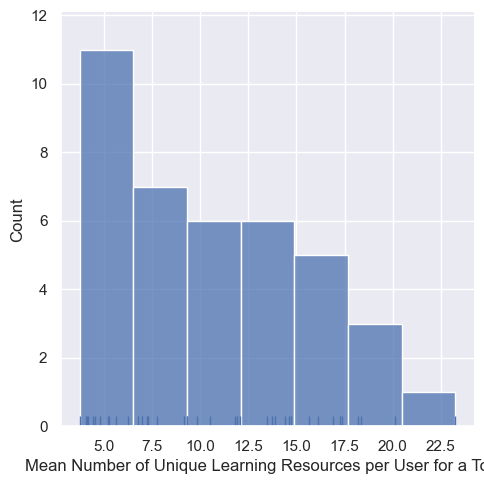



Median:


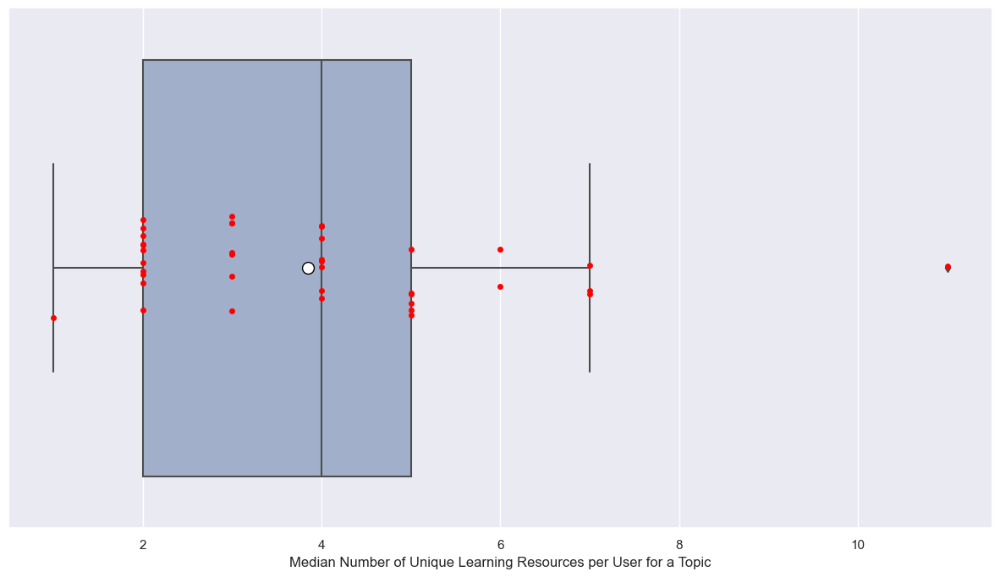

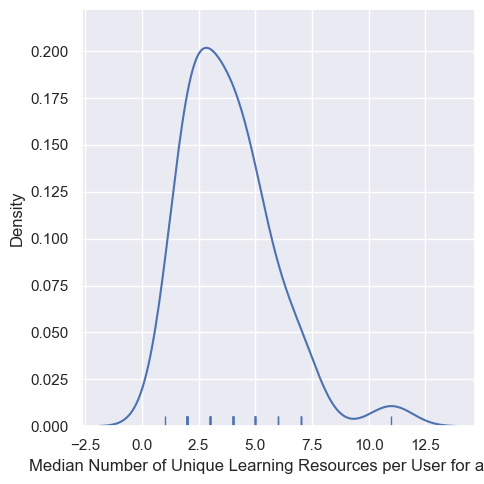

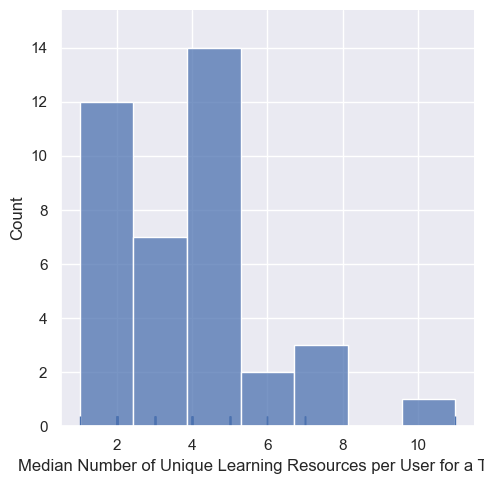

****************************************************************************************************
****************************************************************************************************
 


In [34]:
print_and_plot_group_user_learning_activity_relationship(interactions,
                                                         GROUP_FIELD,
                                                         False)

## Unique Sequence Statistics

In [35]:
learning_activity_sequence_stats_per_group = return_learning_activity_sequence_stats_over_user_per_group(interactions,
                                                                                                         DATASET_NAME,
                                                                                                         GROUP_FIELD_NAME_STR, 
                                                                                                         USER_FIELD_NAME_STR, 
                                                                                                         LEARNING_ACTIVITY_FIELD_NAME_STR,
                                                                                                         TIMESTAMP_FIELD_NAME_STR)

In [36]:
pickle_write(learning_activity_sequence_stats_per_group,
             PATH_TO_SEQUENCE_STATISTICS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_STATISTICS_TABLES_PICKLE_NAME)

### Unique Sequence Statistics

In [37]:
learning_activity_sequence_stats_per_group

,Dataset Name,Topic,Topic_code,Sequence Count,Unique Sequence Count,Learning Resource Sequence,Sequence Frequency,Sequence Frequency %,Sequence Length,Repeated Learning Resources in Sequence,Repeated Learning Resources in Sequence %,Number of Unique Learning Resources in Sequence,% of Unique Learning Resources per Topic in Sequence
8,kdd_2015,0,0,7213,3813,"(12,)",941,13.045889,1,0,0.000000,1,2.000000
38,kdd_2015,0,0,7213,3813,"(12, 13)",278,3.854152,2,0,0.000000,2,4.000000
56,kdd_2015,0,0,7213,3813,"(12, 13, 14)",232,3.216415,3,0,0.000000,3,6.000000
9,kdd_2015,0,0,7213,3813,"(0,)",225,3.119368,1,0,0.000000,1,2.000000
21,kdd_2015,0,0,7213,3813,"(13,)",187,2.592541,1,0,0.000000,1,2.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
39212,kdd_2015,9,38,1396,908,"(735, 581, 582, 583, 584, 587, 589, 590, 591, ...",1,0.071633,16,2,12.500000,14,11.965812
39213,kdd_2015,9,38,1396,908,"(576, 578, 579, 576, 577, 578, 576, 580, 596, ...",1,0.071633,23,11,47.826087,12,10.256410
39214,kdd_2015,9,38,1396,908,"(576, 577, 578, 579, 580, 579, 581, 582, 583, ...",1,0.071633,91,42,46.153846,49,41.880342
39215,kdd_2015,9,38,1396,908,"(576, 577, 581, 577, 581, 577, 582, 578, 583, ...",1,0.071633,25,6,24.000000,19,16.239316


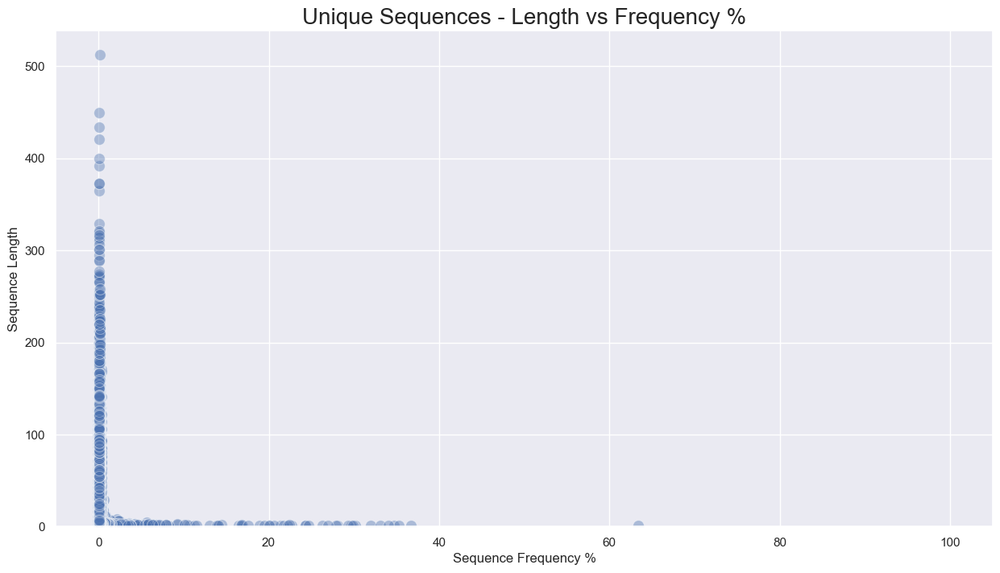

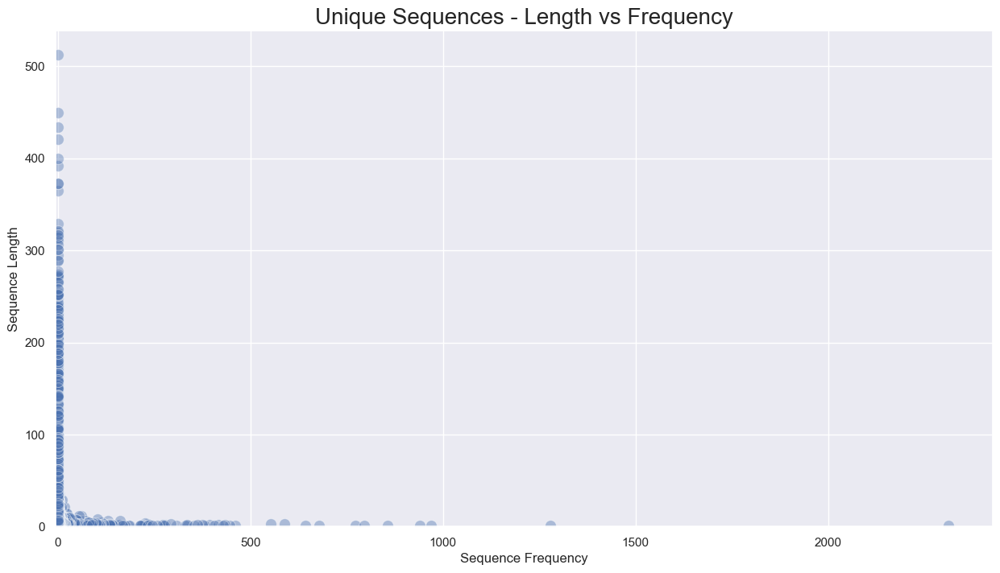

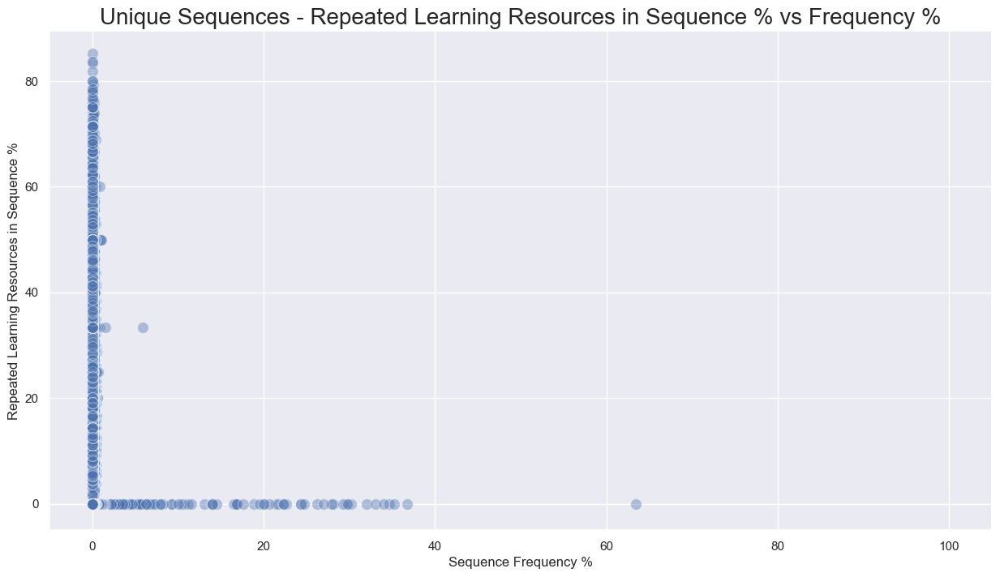

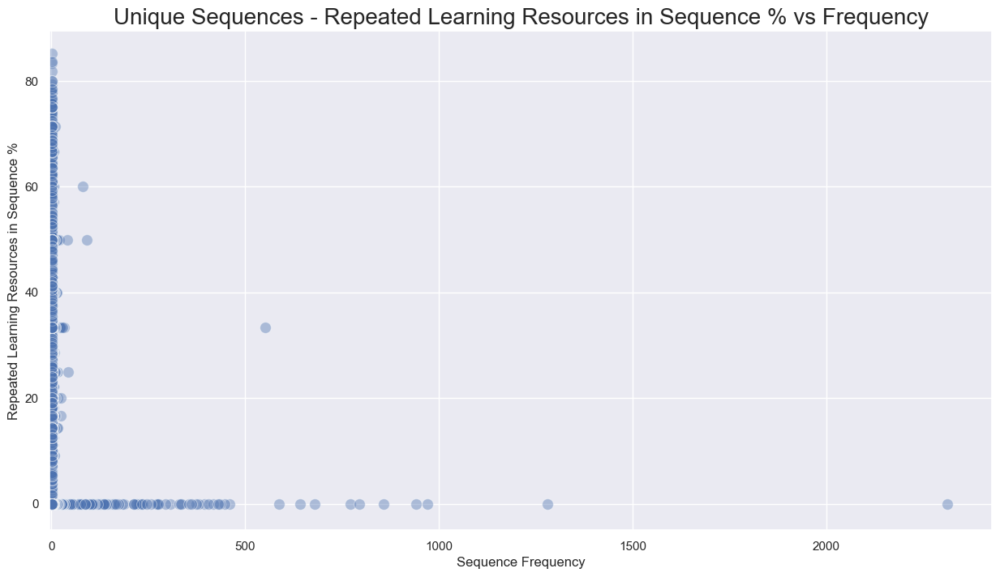

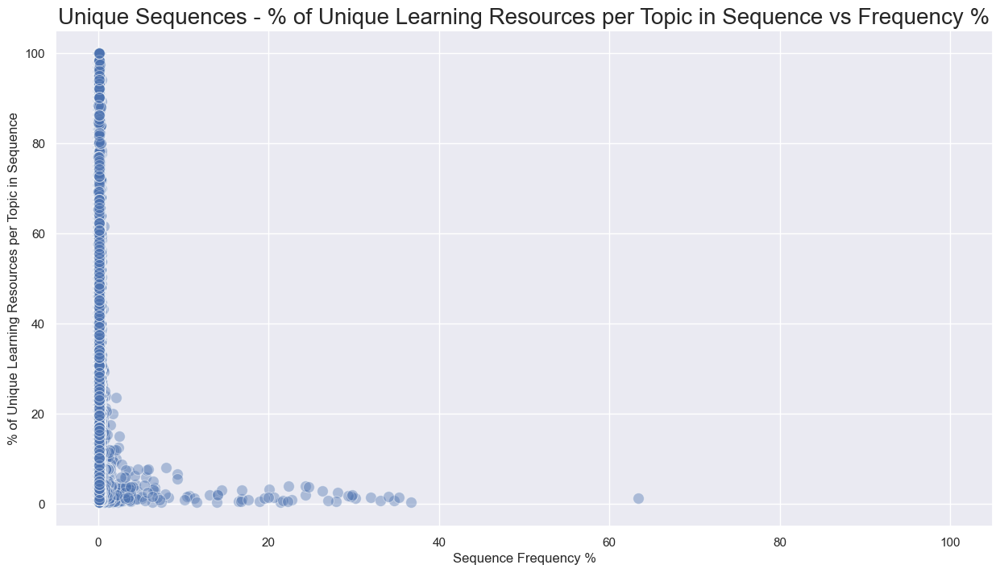

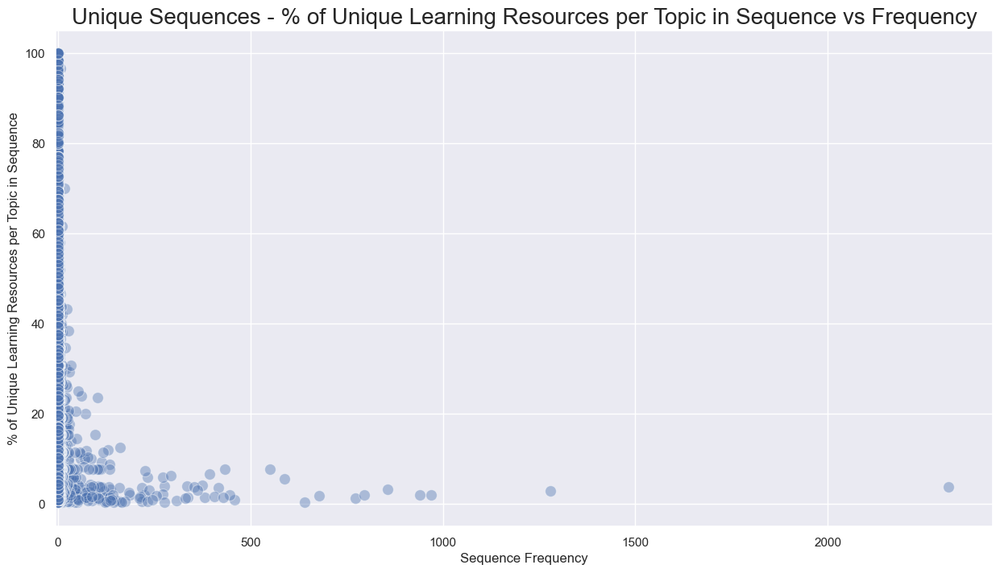

In [38]:
plot_sequence_stats(learning_activity_sequence_stats_per_group)

### Unique Sequence Statistics per Group

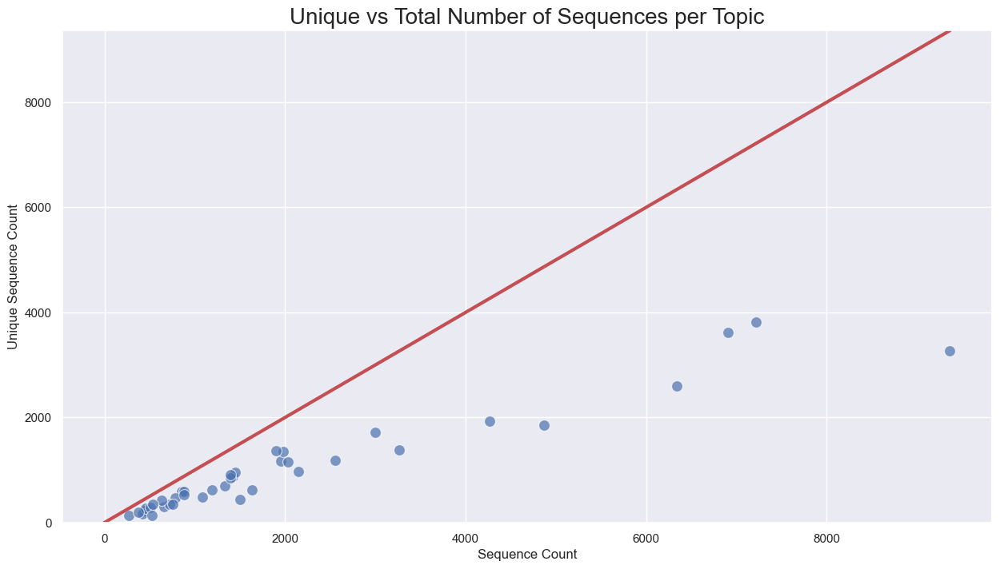

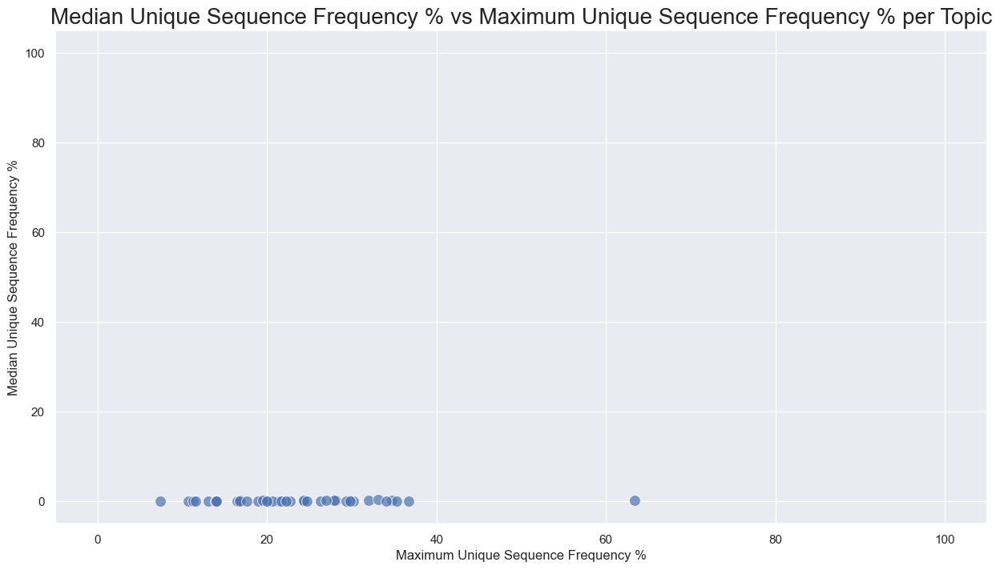

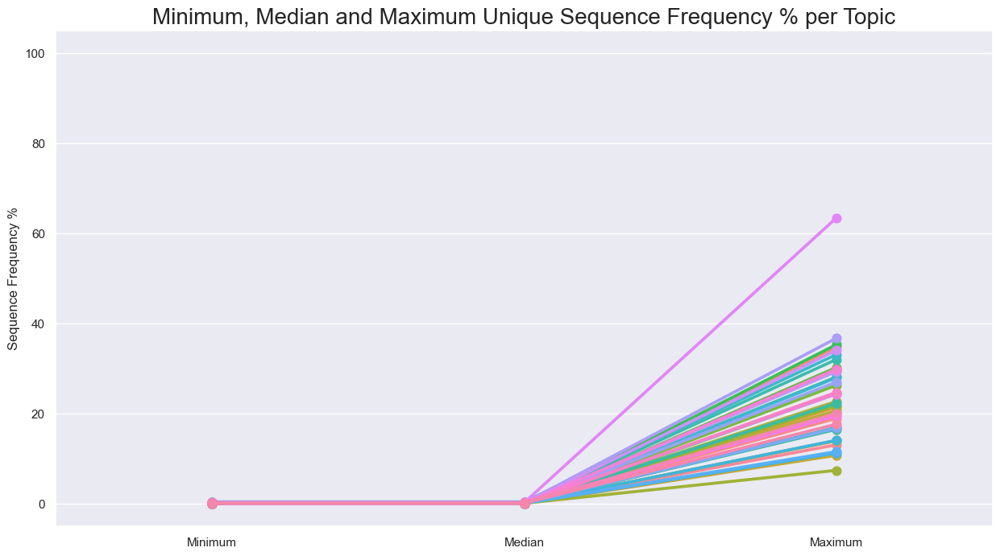

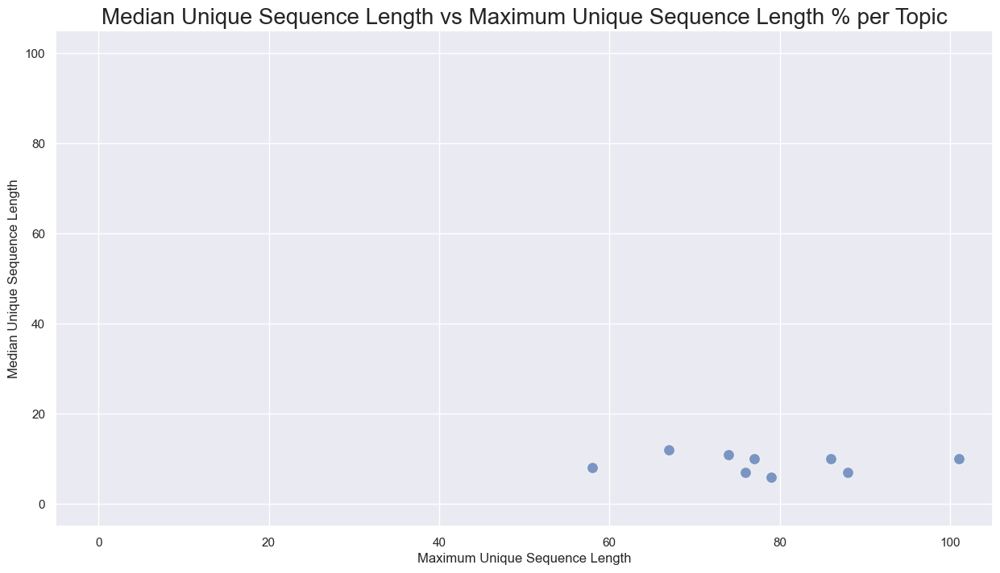

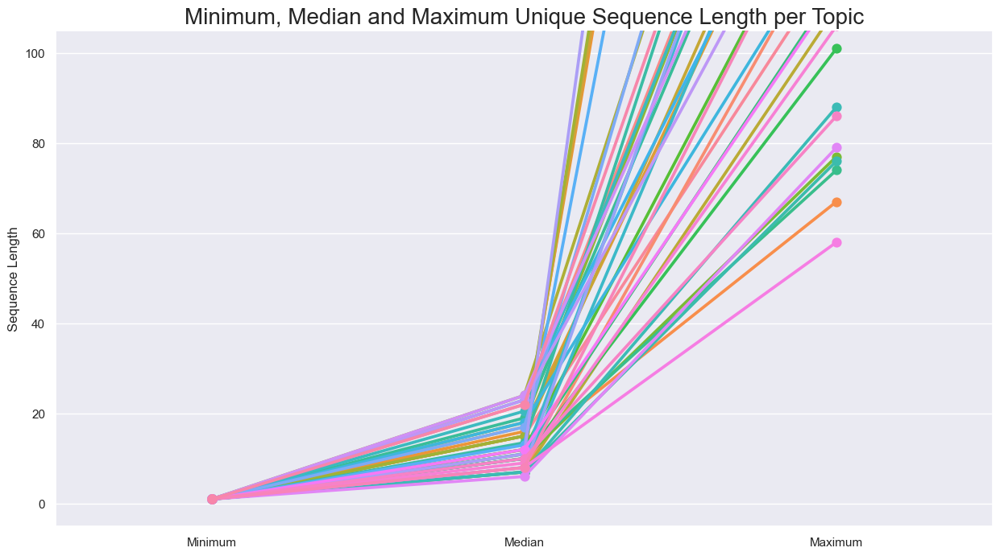

...

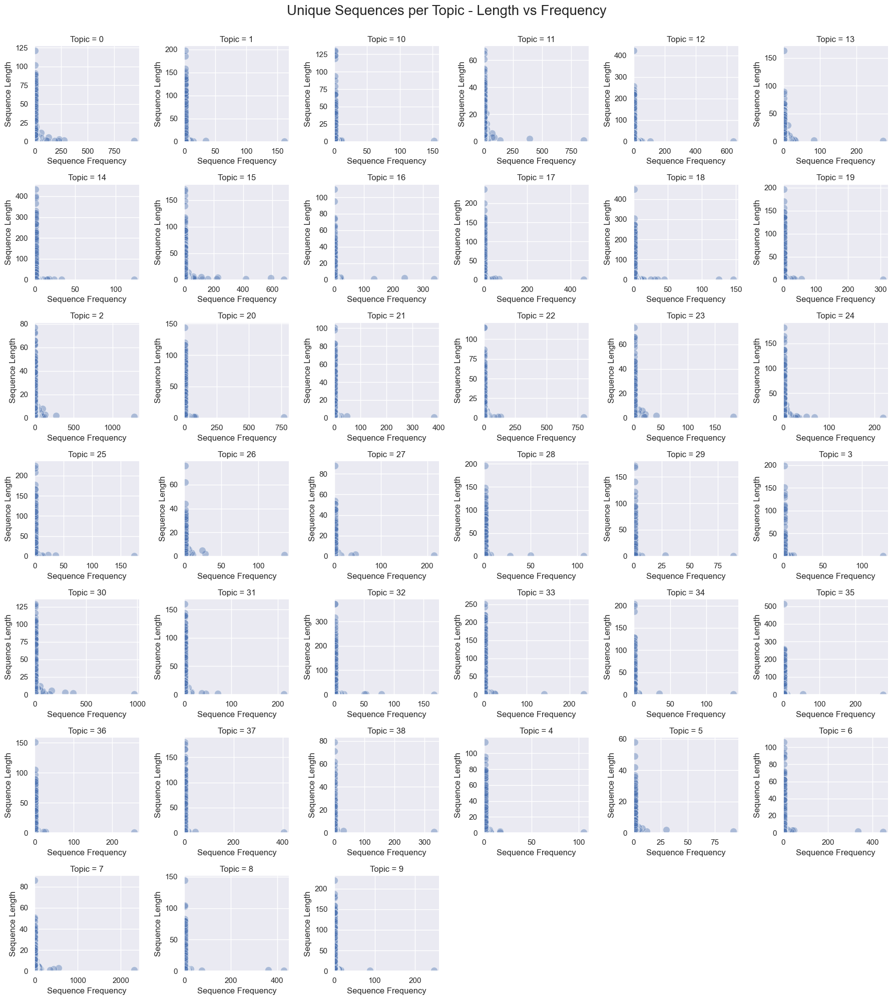

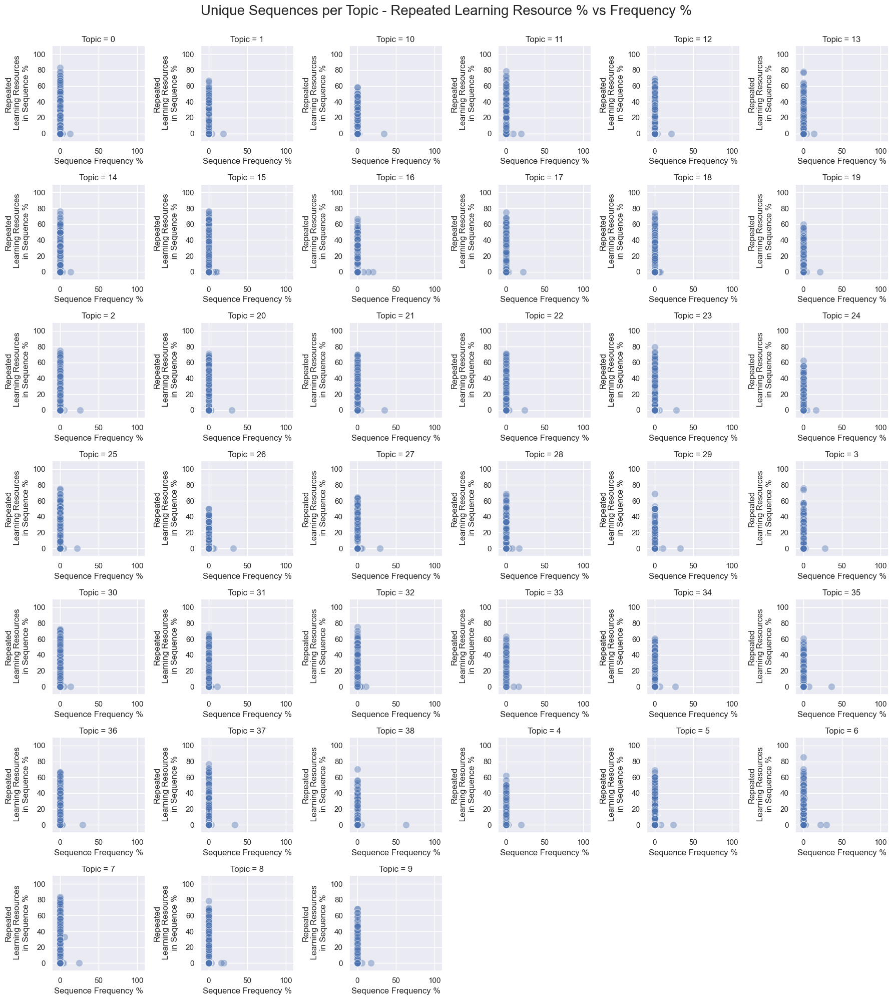

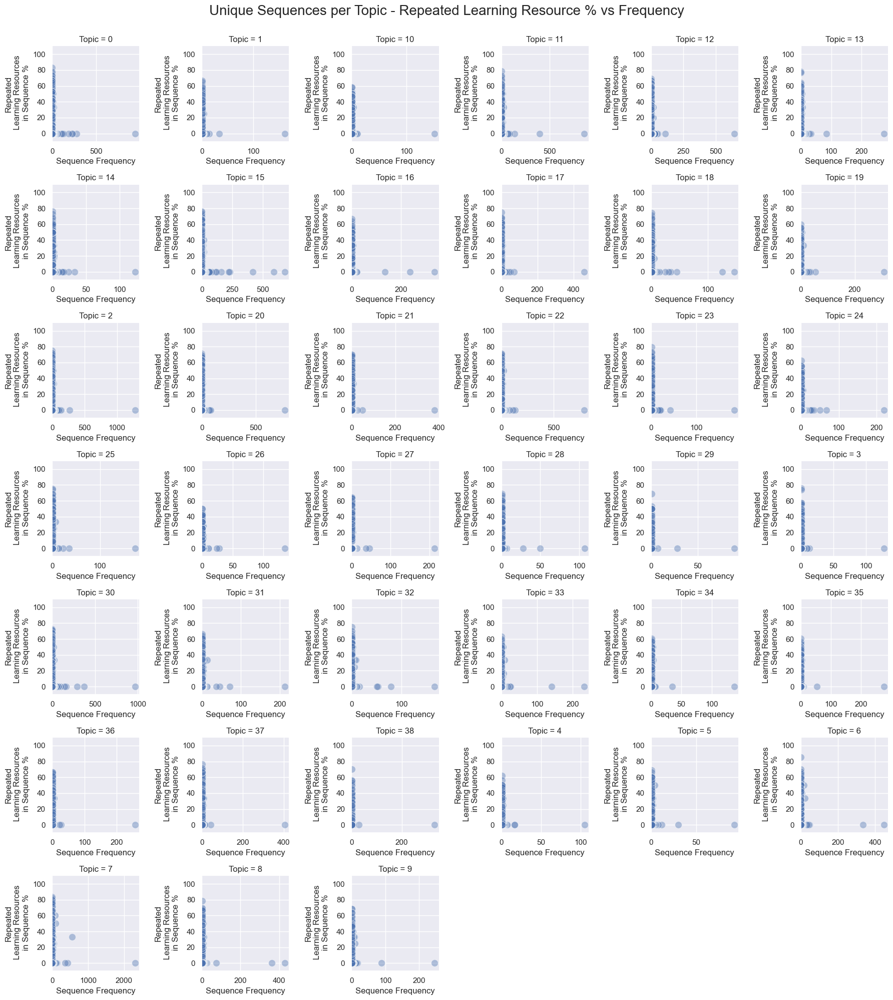

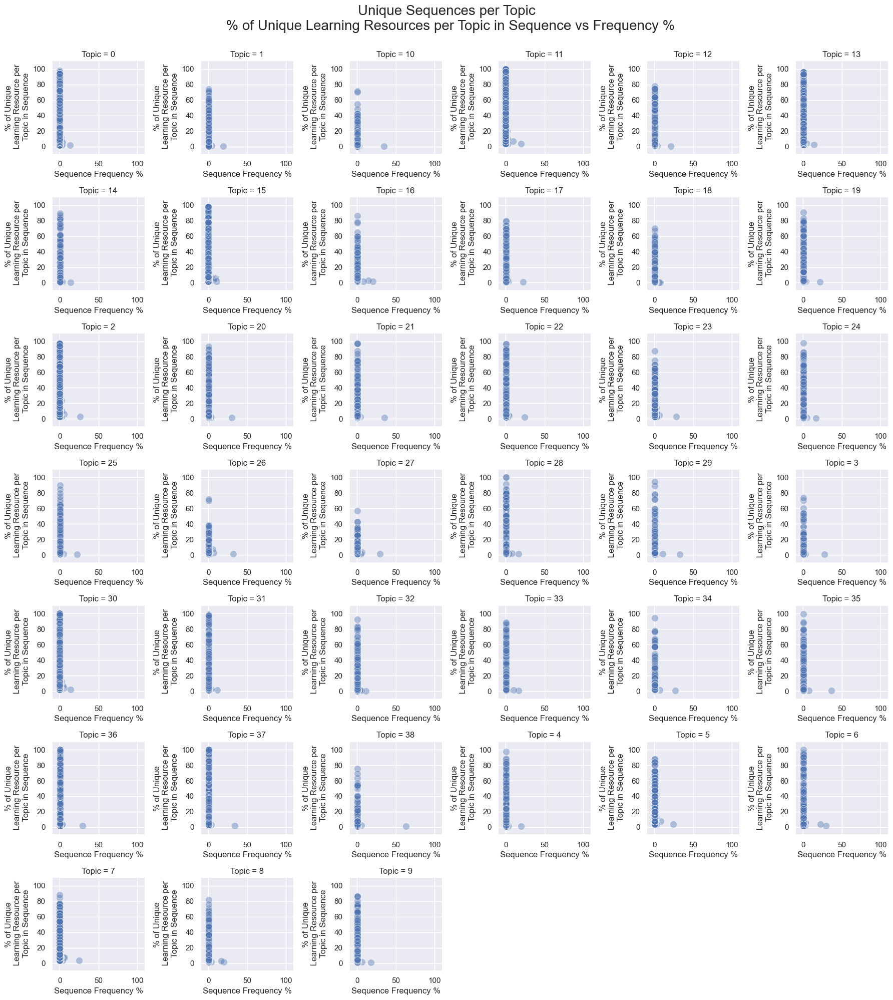

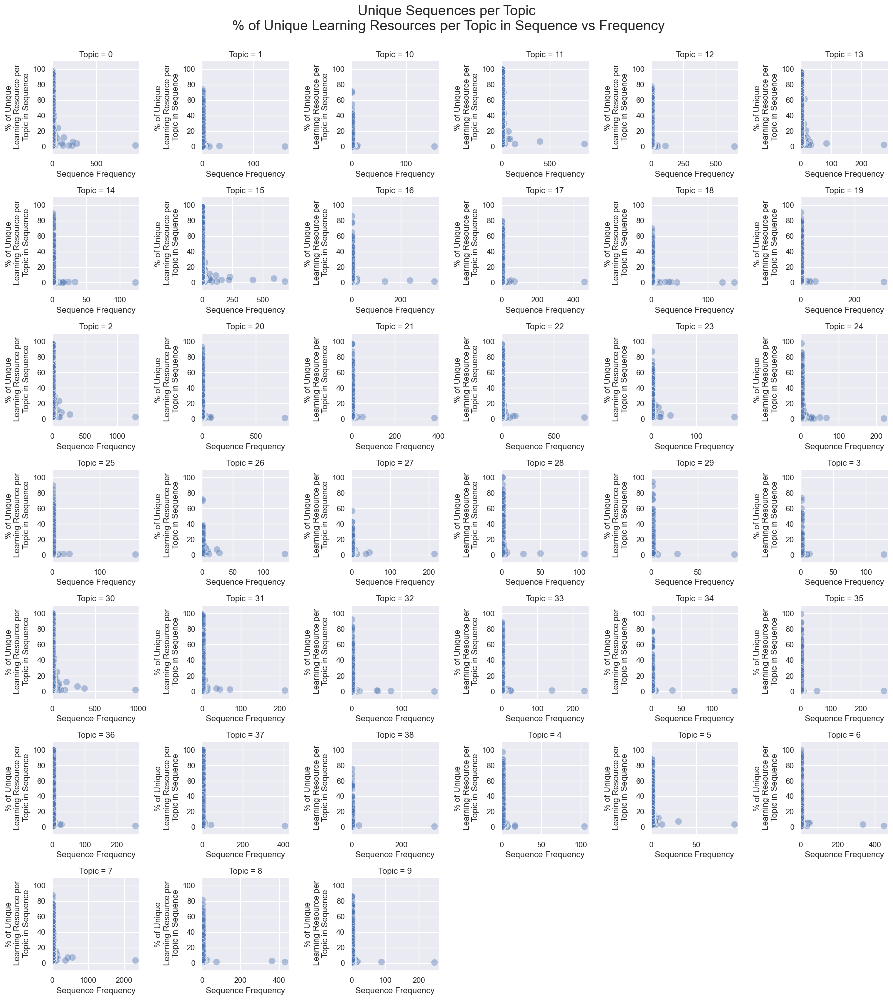

In [39]:
plot_sequence_stats_per_group(learning_activity_sequence_stats_per_group,
                              GROUP_FIELD_NAME_STR)

## Sequence Distance

In [40]:
seq_distances = calculate_sequence_distances(interactions, 
                                             USER_FIELD_NAME_STR, 
                                             GROUP_FIELD_NAME_STR, 
                                             LEARNING_ACTIVITY_FIELD_NAME_STR, 
                                             SEQUENCE_ID_FIELD_NAME_STR)

--------------------
Topic-Field Available:
Calulate Sequence Distances for each Topic
--------------------
--------------------------------------------------
Total number of Topic: 39
--------------------------------------------------
--------------------------------------------------
Final number of Topics: 39
Final number of Users: 57747
Final number of interactions: 1016073
--------------------------------------------------


100%|██████████| 39/39 [05:20<00:00,  8.22s/it]

--------------------------------------------------
Duration in seconds: 321.58357787132263
--------------------------------------------------


In [41]:
pickle_write(seq_distances,
             PATH_TO_SEQUENCE_DISTANCES_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_DISTANCE_DICT_PER_GROUP_PICKLE_NAME)

100%|██████████| 39/39 [00:13<00:00,  2.92it/s]


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


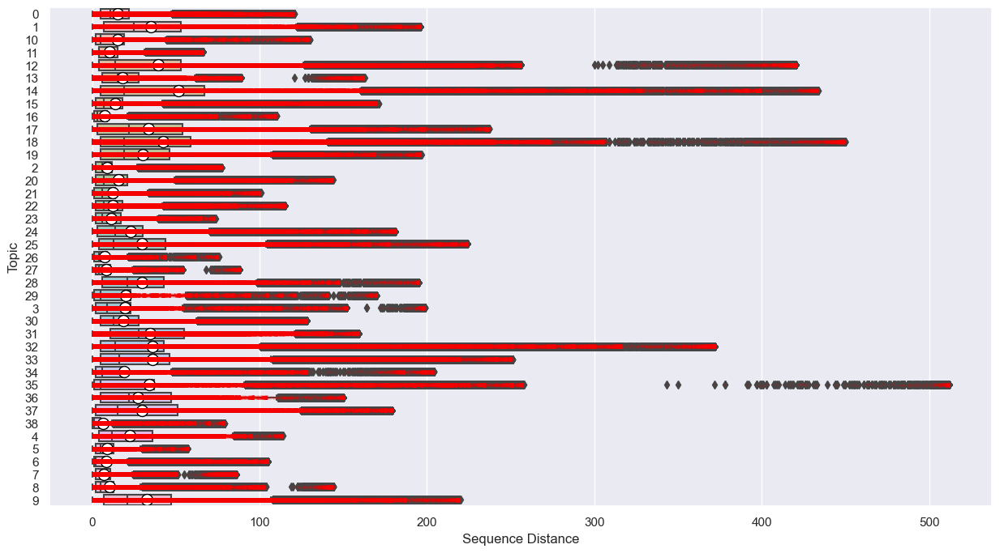

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations
----------------------------------------------------------------------------------------------------


Plots:


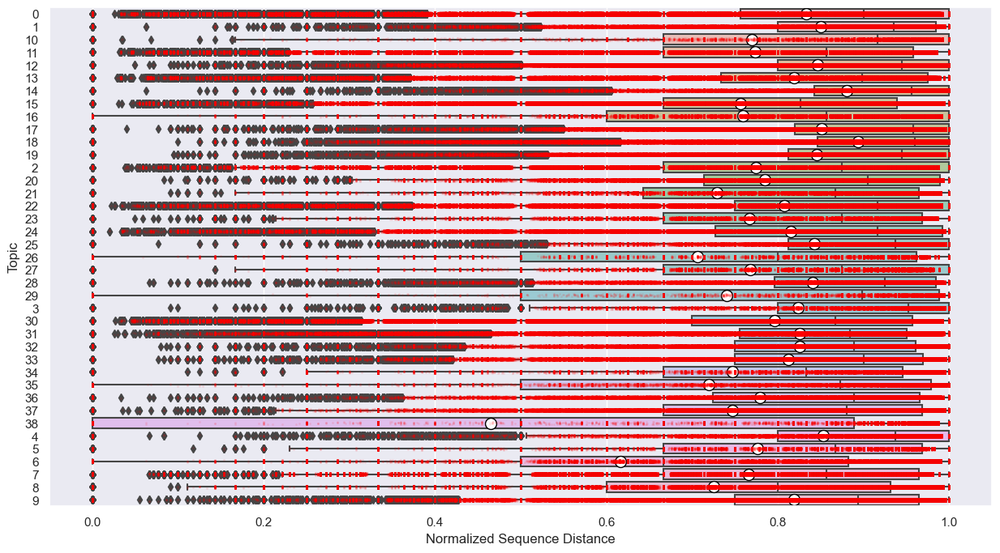

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


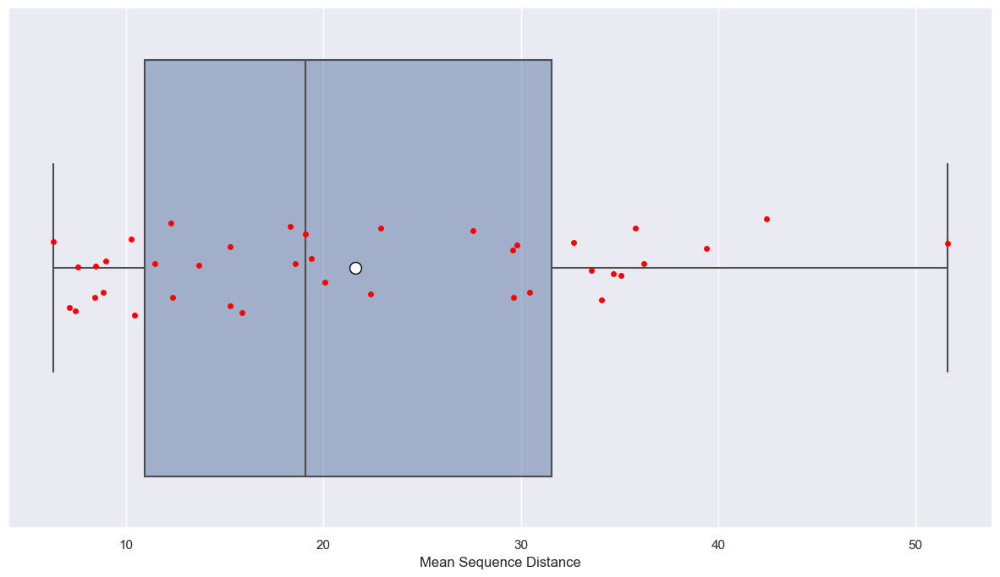

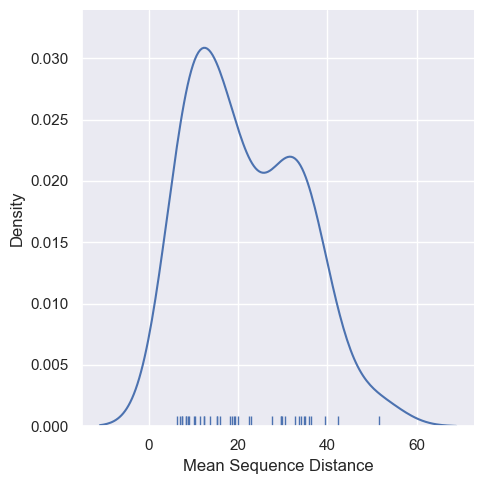

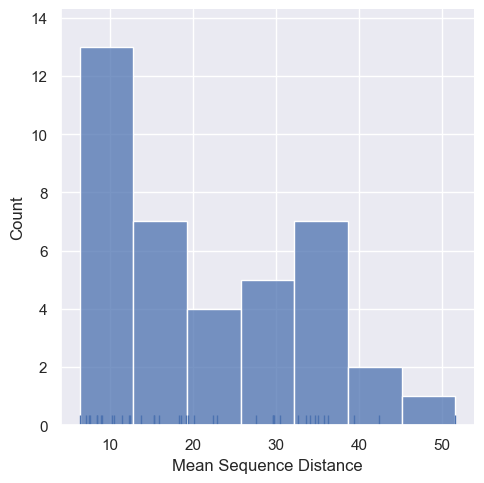

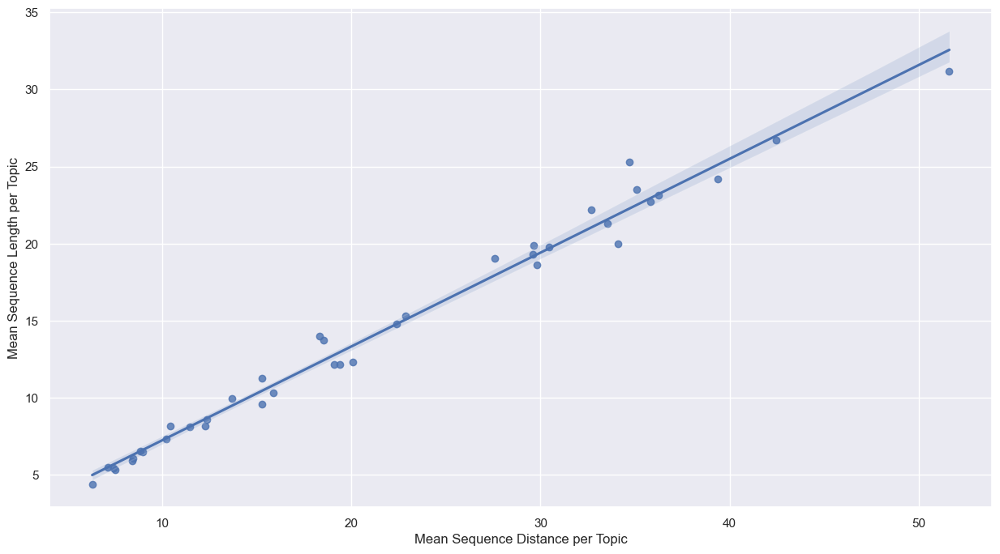

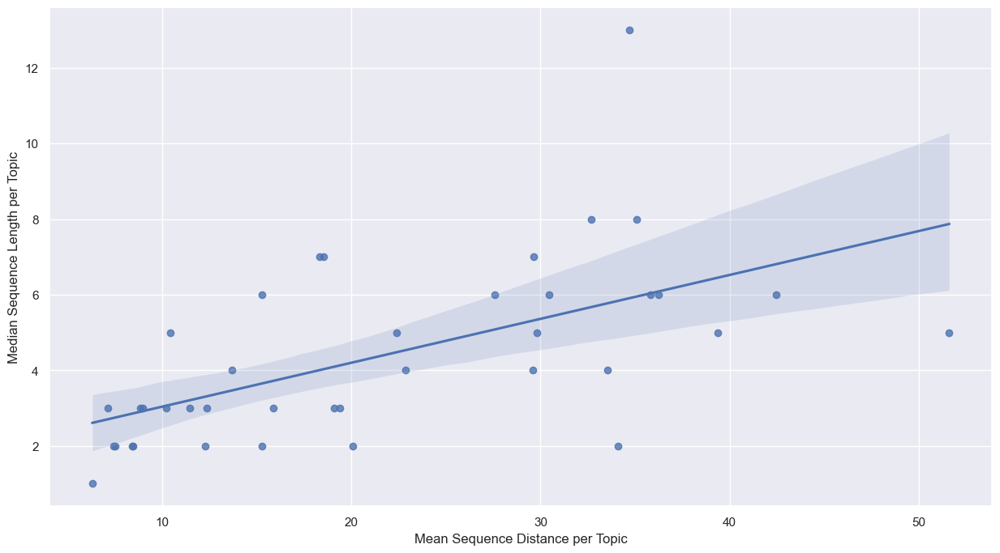

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


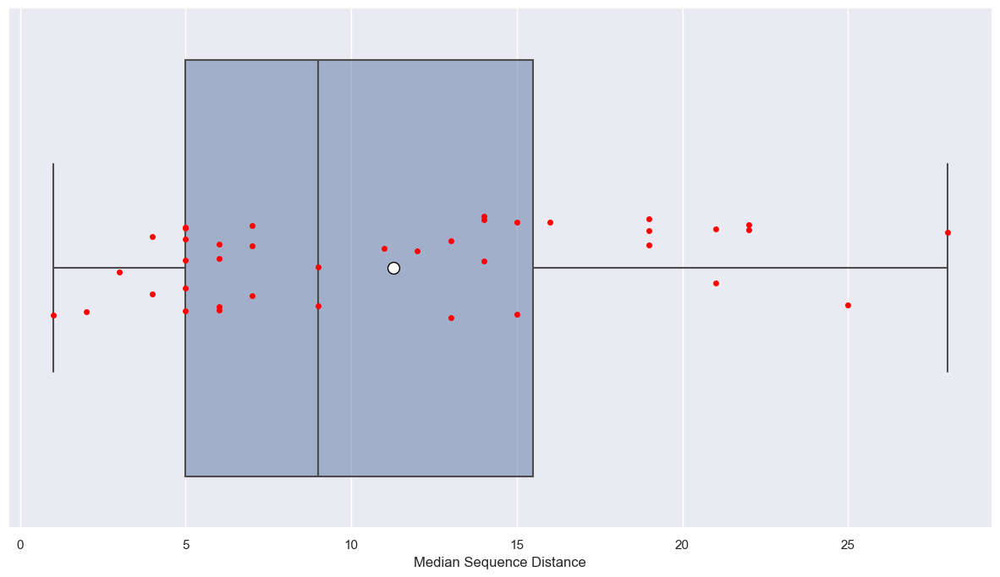

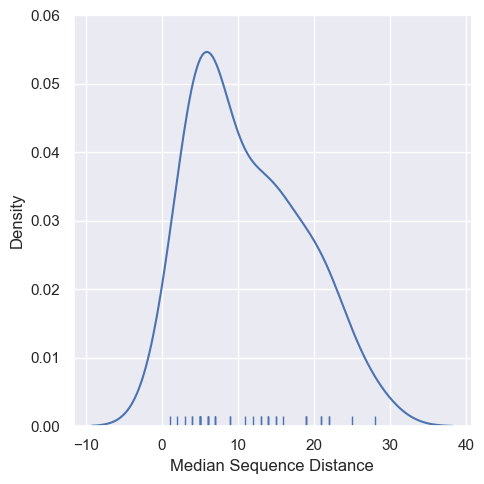

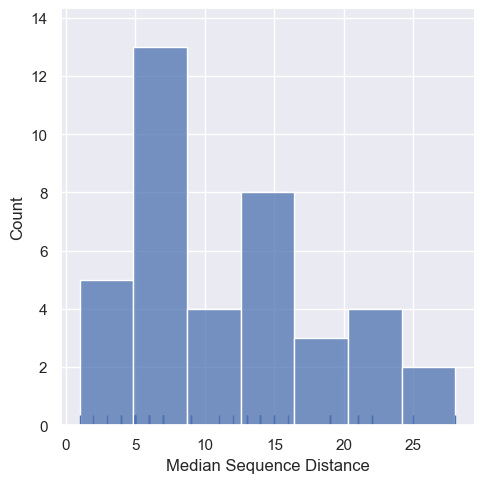

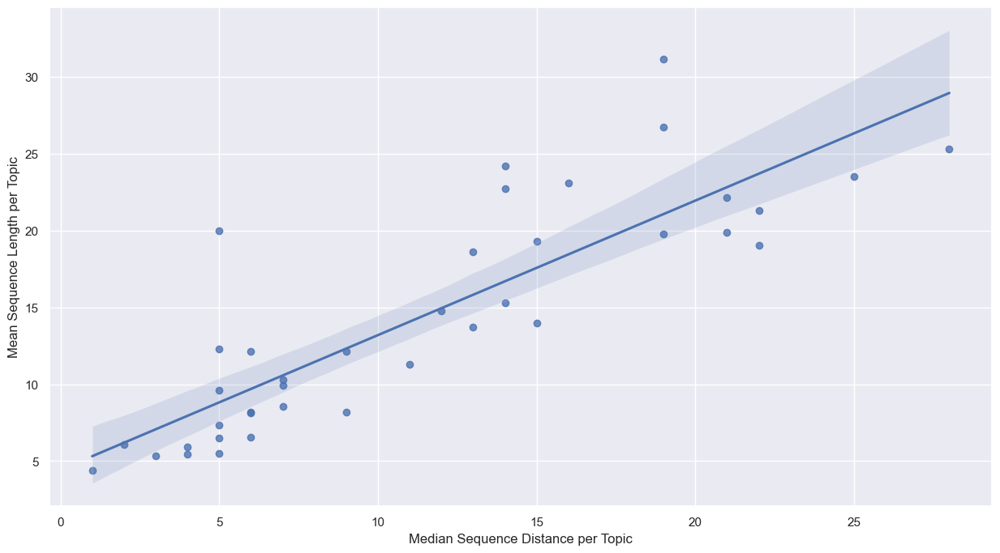

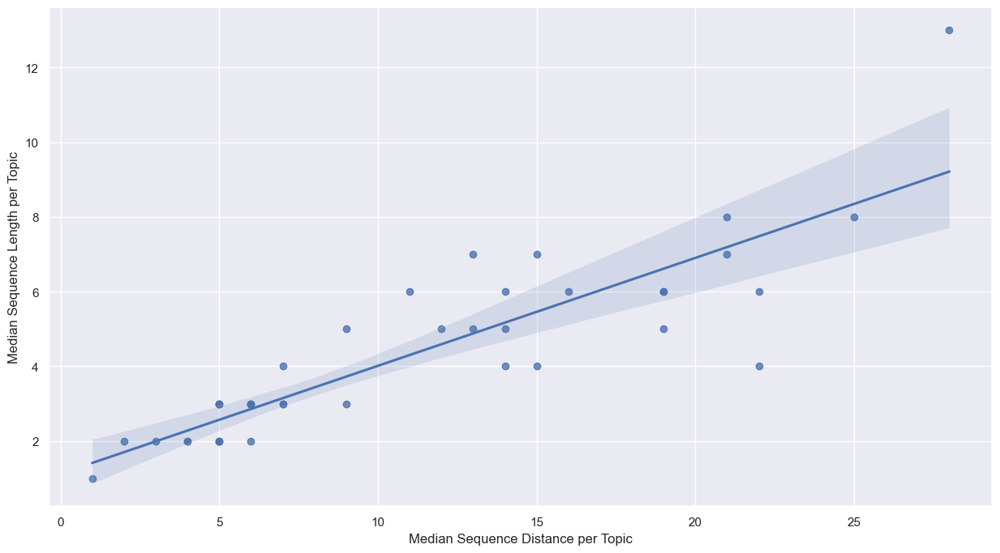

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Mean Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


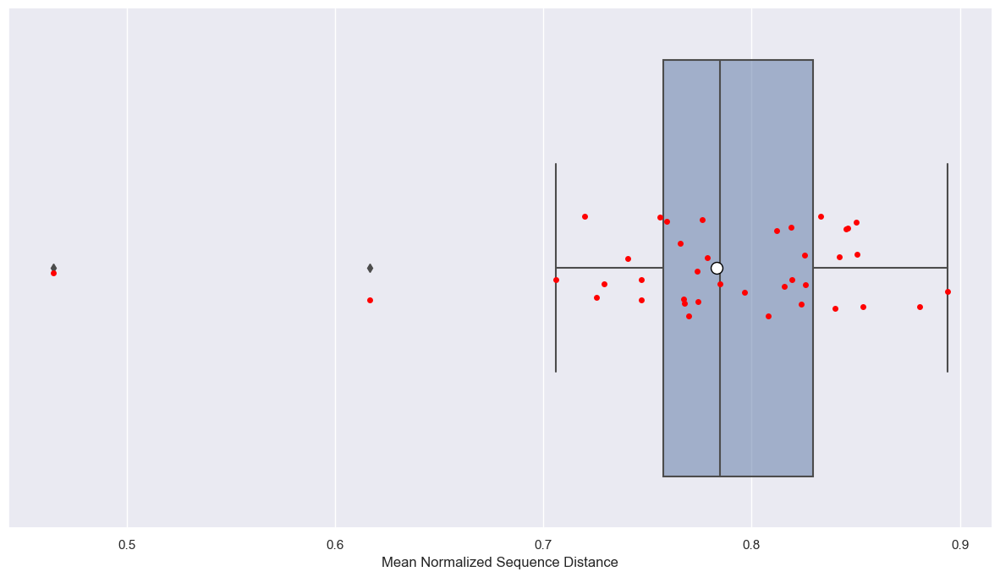

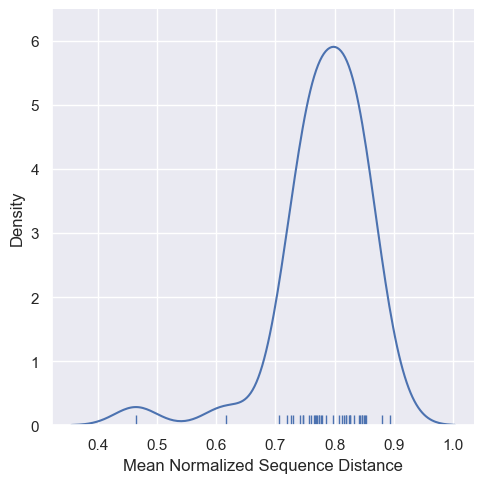

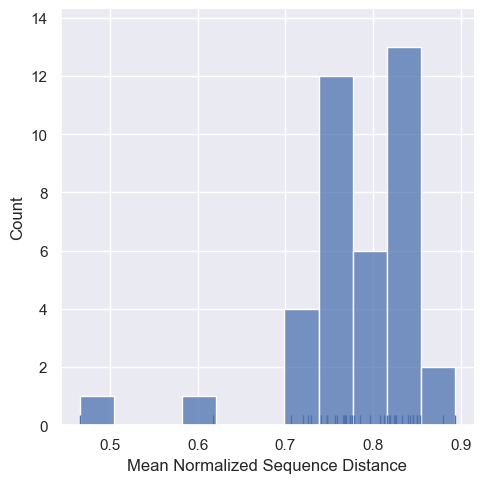

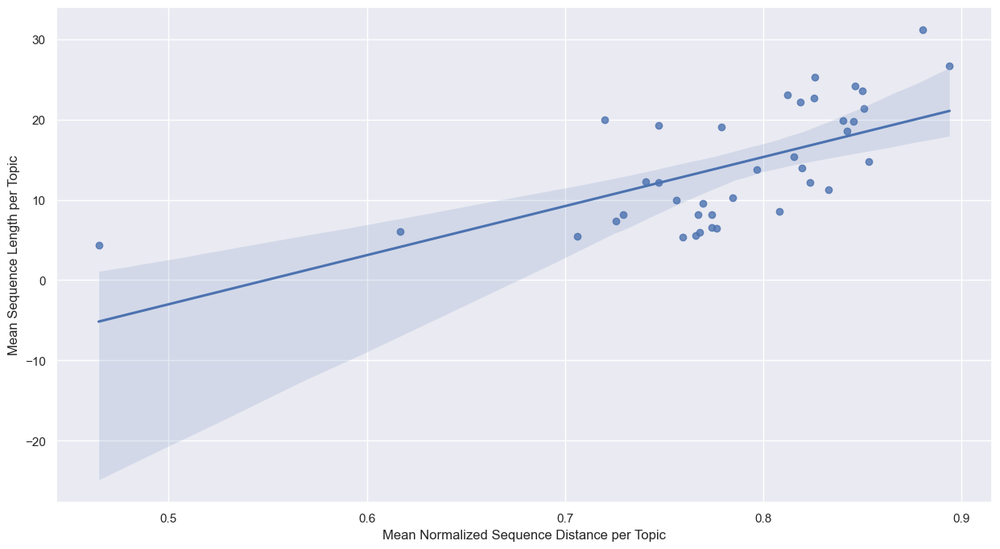

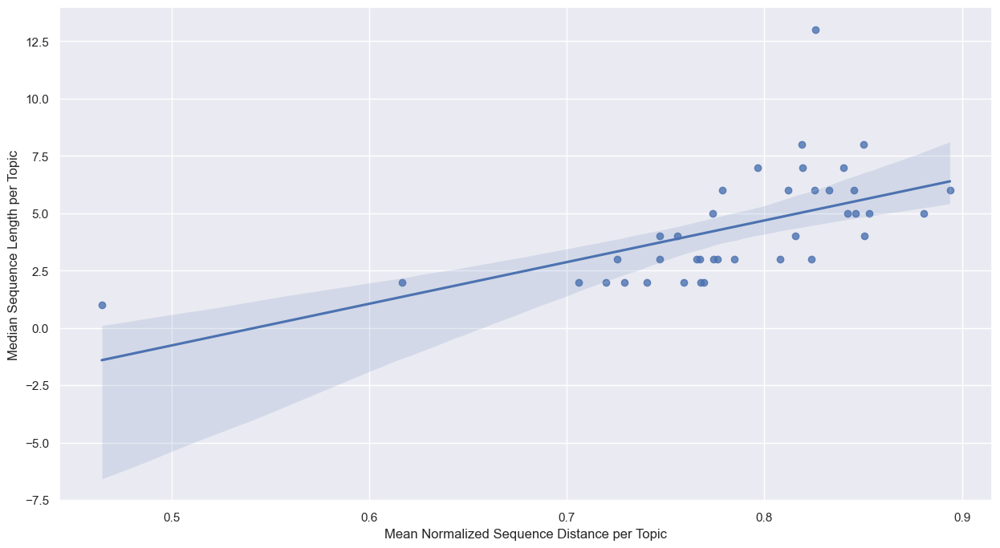

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Median Normalized Sequence Distance per Topic:
----------------------------------------------------------------------------------------------------


Plots:


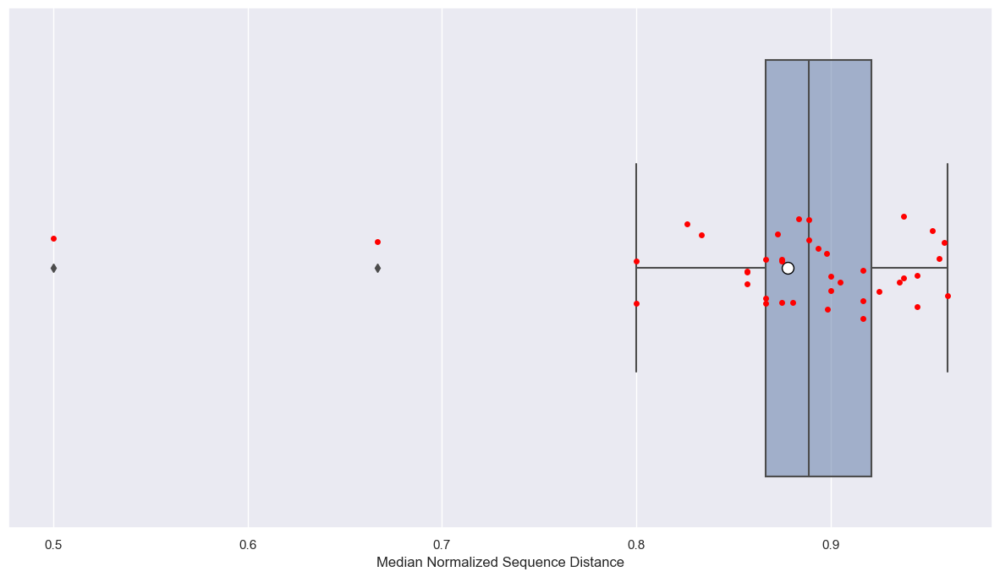

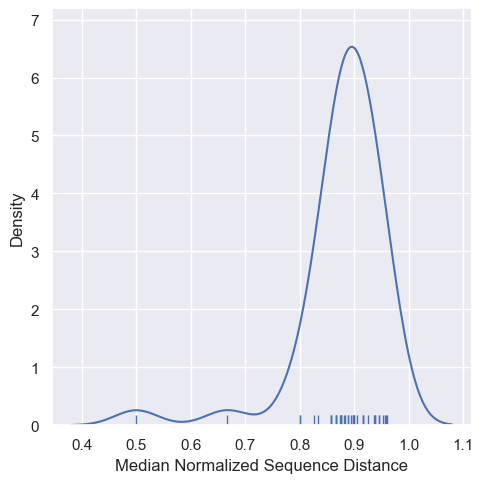

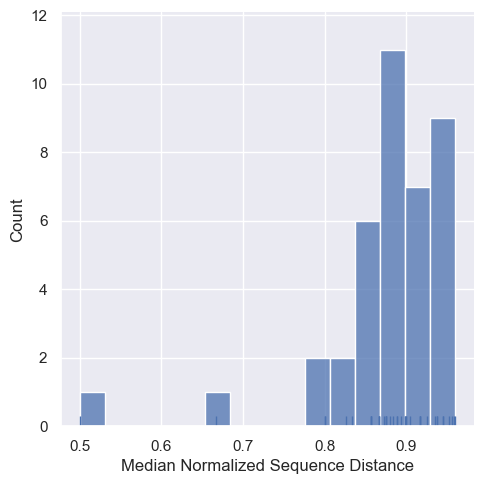

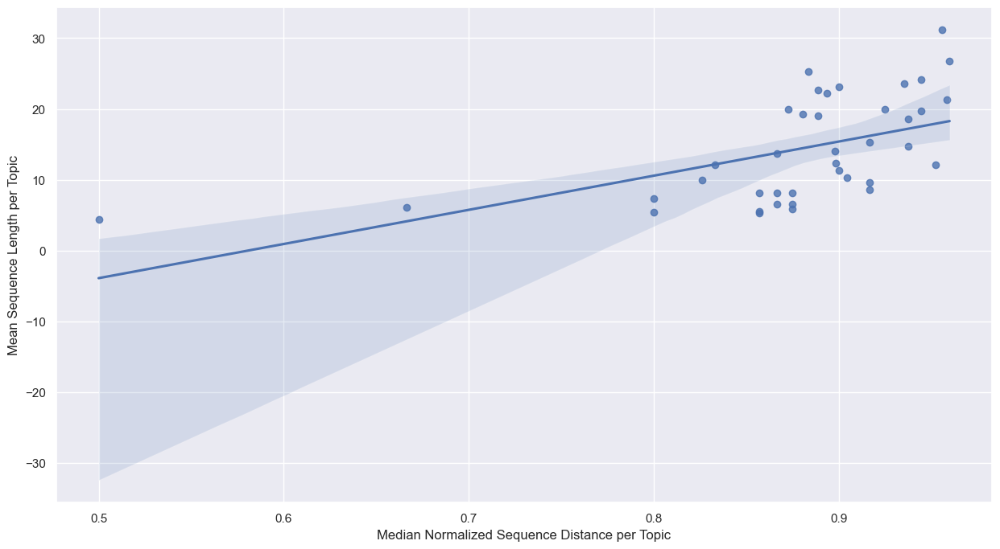

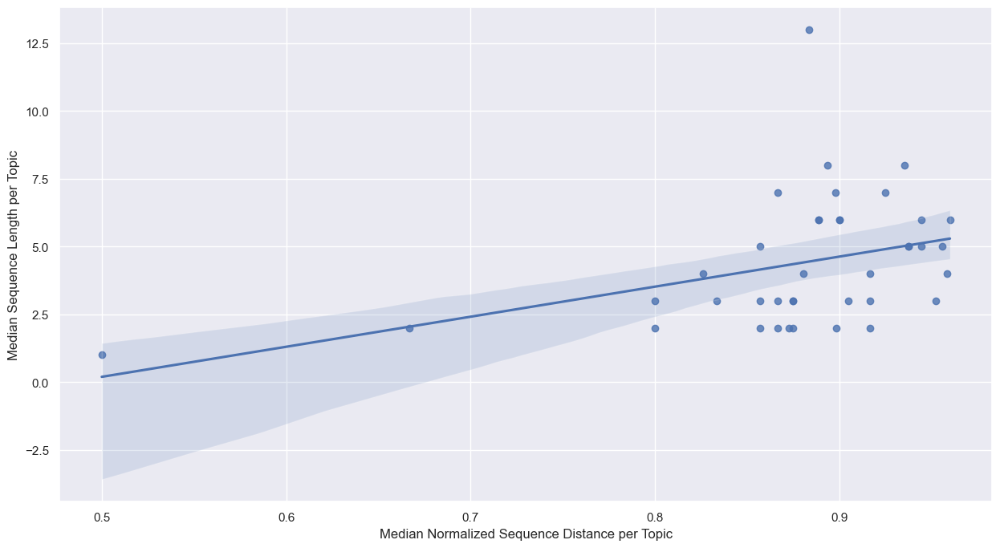

****************************************************************************************************
****************************************************************************************************
 


In [42]:
plot_sequence_distances(seq_distances)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


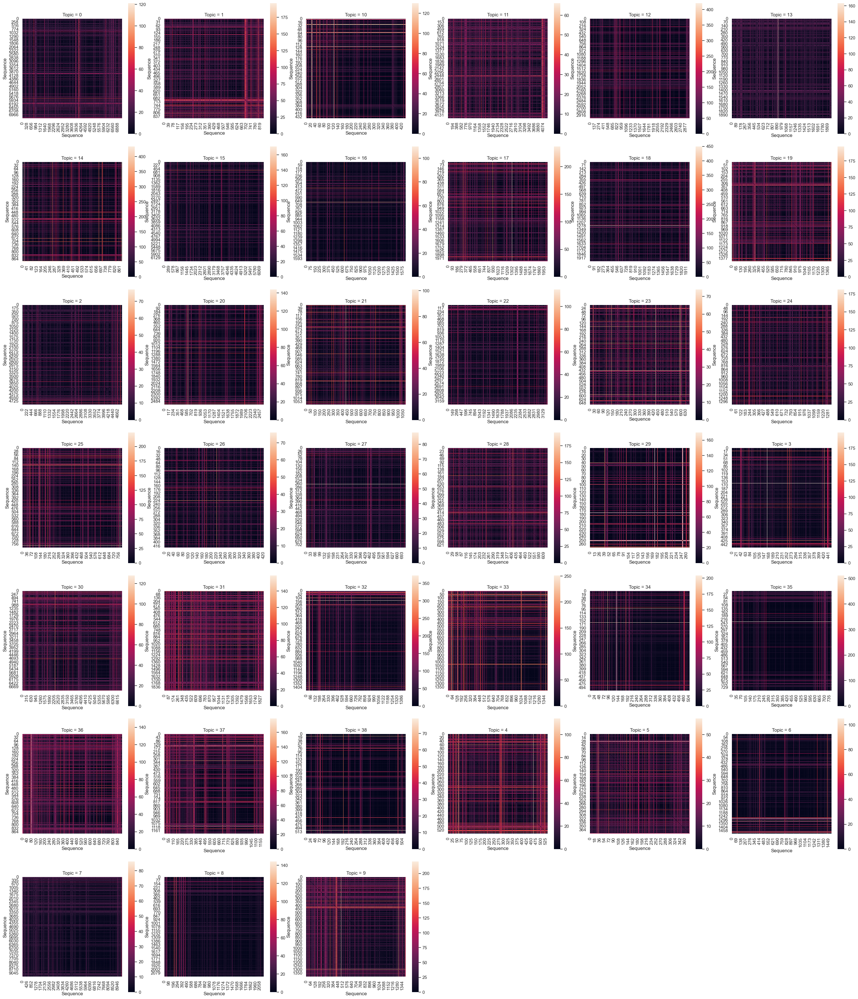

In [43]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        False,
                                        5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Normalized Sequence Distance Matrix per Topic:
----------------------------------------------------------------------------------------------------


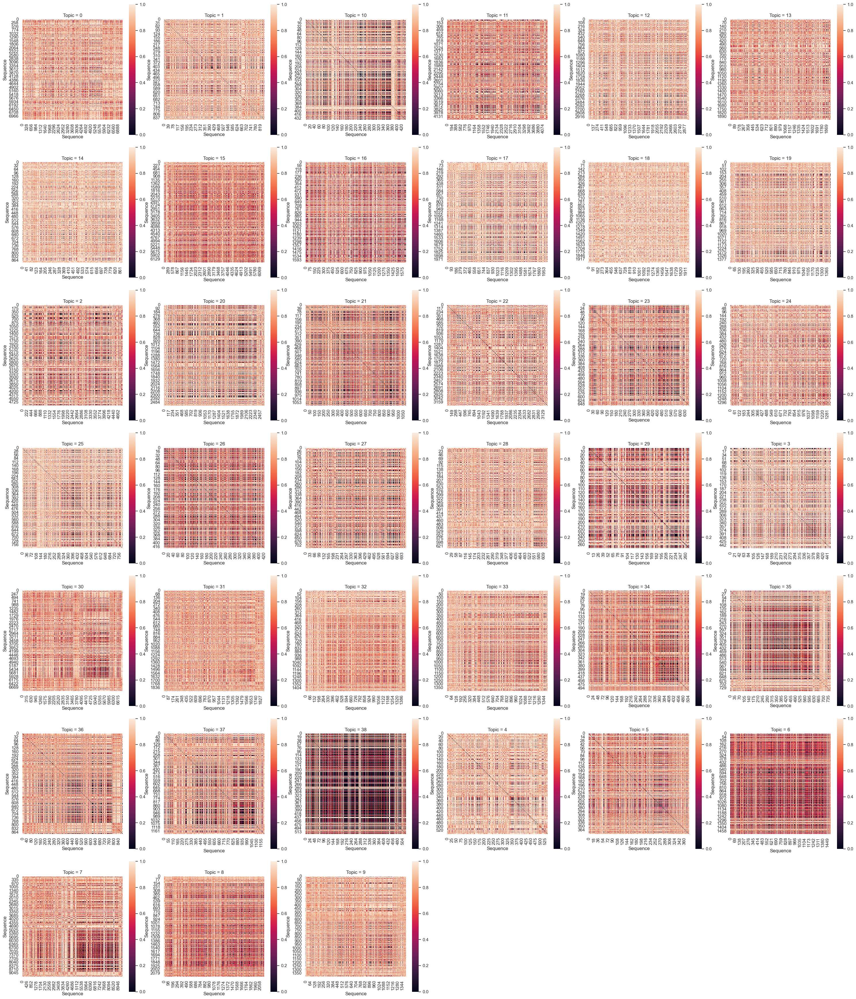

In [44]:
plot_sequence_distance_matrix_all_group(seq_distances,
                                        True,
                                        5)

## Clustering of Sequence Distances and Testing for Evaluation Metric Central Tendency Differences between Clusters 

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Topic Selection Criteria
----------------------------------------------------------------------------------------------------
 
Unique vs Total Number of Sequences per Topic:


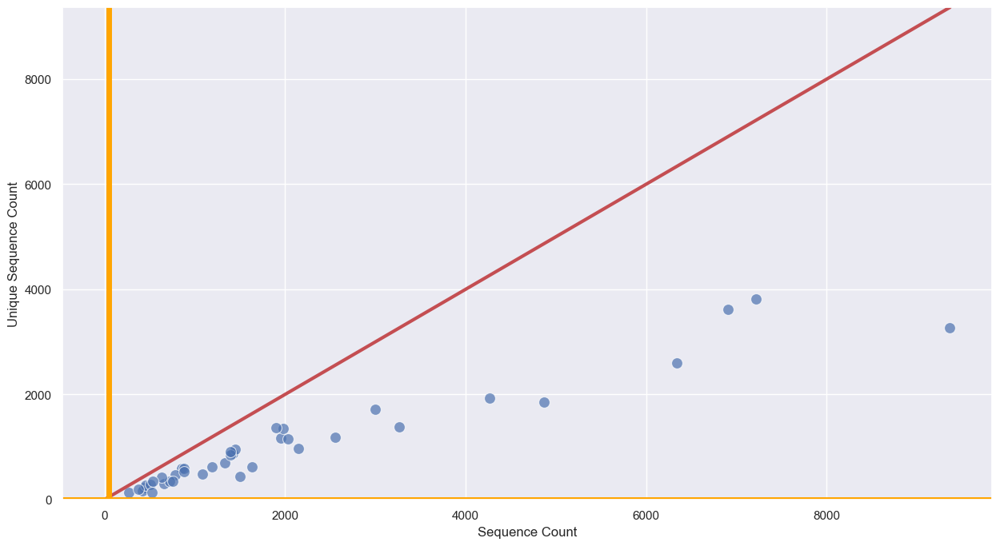

Normalized Sequence Distance per Topic:
Base: All User-Sequence Combinations


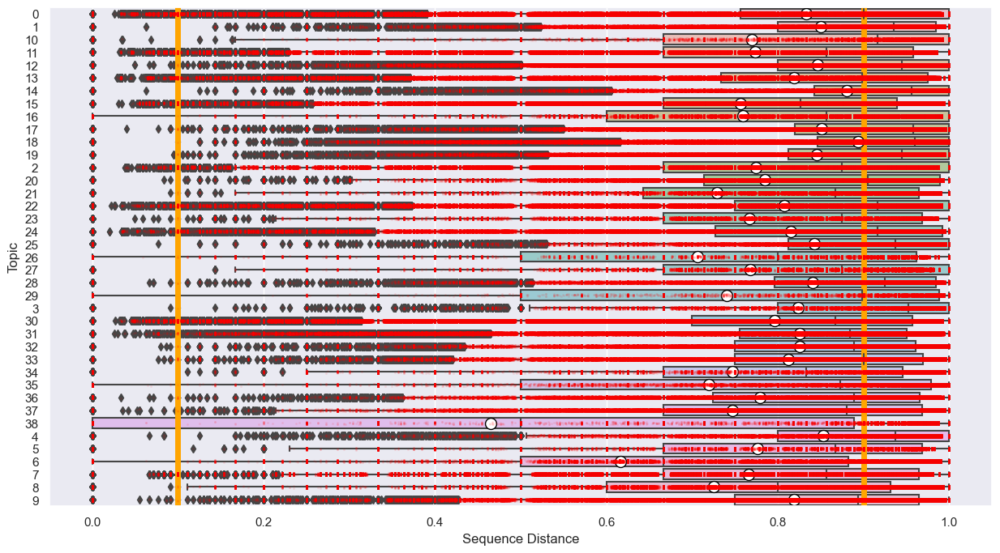

 
****************************************************************************************************
****************************************************************************************************


In [45]:
ClusterAnalysisPlotGroupSelectionCriteria(DATASET_NAME,
                                          learning_activity_sequence_stats_per_group,
                                          seq_distances,
                                          True,
                                          50,
                                          5,
                                          (0.1, 0.9)).display_group_selection_criteria()

In [46]:
cluster_eval = ClusterEvaluation(DATASET_NAME, 
                                 interactions, 
                                 USER_FIELD_NAME_STR, 
                                 GROUP_FIELD_NAME_STR, 
                                 EVALUATION_GROUP_SCORE_HIGHEST_ALL_LEARNING_ACTIVITIES_MEAN_FIELD_NAME_STR,
                                 seq_distances,
                                 True,
                                 50,
                                 5,
                                 (0.1, 0.9),
                                 hdbscan.HDBSCAN,
                                 0.025,
                                 0.05,
                                 0.05,
                                 metric='precomputed',
                                 cluster_selection_method='eom')

In [47]:
cluster_eval.cluster_sequences_and_test_eval_metric_diff()
cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test_over_groups()

  0%|          | 0/39 [00:02<?, ?it/s]


TypeError: '>' not supported between instances of 'NoneType' and 'float'

In [ ]:
pickle_write(cluster_eval,
             PATH_TO_SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PICKLE_FOLDER,
             DATASET_NAME + SEQUENCE_CLUSTER_EVALUATION_METRIC_ANALYSIS_PER_GROUP_OBJECT_PICKLE_NAME)

In [ ]:
cluster_stats_per_group = cluster_eval.cluster_stats_per_group
cluster_eval_metric_central_tendency_differences_per_group = cluster_eval.cluster_eval_metric_central_tendency_differences_per_group
aggregate_sequence_clustering_and_eval_metric_diff_test = cluster_eval.aggregate_sequence_clustering_and_eval_metric_diff_test
group_cluster_analysis_inclusion_status = cluster_eval.group_cluster_analysis_inclusion_status
min_cluster_size_correction_df = cluster_eval.min_cluster_size_correction_df

In [ ]:
cluster_stats_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Percentage Clustered,Cluster,Number of Sequences per Cluster,Number of Unique Sequences per Cluster,User,Sequence ID,Sequence Length,Sequence Array,Mean Evaluation Metric,Median Evaluation Metrice,Min Evaluation Metric Value,Max Evaluation Metric Value,STD Evaluation Metric Value,IQR Evaluation Metric Value
0,csedm_2021,0,500,142,74.4,-1,128,116,"[107, 108, 11, 111, 114, 116, 119, 120, 127, 1...","[2, 3, 4, 5, 6, 8, 10, 11, 13, 14, 15, 16, 17,...","[10, 11, 12, 12, 14, 14, 11, 2, 13, 13, 10, 10...","[(4, 5, 8, 6, 0, 1, 9, 2, 7, 3), (4, 5, 8, 7, ...",0.835129,0.889153,0.0,1.0,0.210356,0.197641


In [ ]:
cluster_eval_metric_central_tendency_differences_per_group.head(1)

,Dataset Name,Topic,Number of Sequences,Number of Unique Sequences,Mean Normalized Sequence Distance,Median Normalized Sequence Distance,Min Normalized Sequence Distance,Max Normalized Sequence Distance,STD Normalized Sequence Distance,IQR Normalized Sequence Distance,Clustering Algorithm,HDBSCAN Min Cluster Size,Number of Clusters,Percentage Clustered,Mean Cluster Size,Median Cluster Size,Min Cluster Size,Max Cluster Size,STD Cluster Size,IQR Cluster Size,Cluster Comparision Evaluation Metric,Normality Test Shapiro P-Value,Normality Test Jarque-Bera P-Value,Normality Test D'Agostion-Pearson P-Value,Homoscedasticity Test Levene P-Value,Homoscedasticity Test Bartlett P-Value,Central Tendency Differences Test Type,Central Tendency Differences Test P-Value
0,csedm_2021,0,500,142,0.208946,0.090909,0.0,1.0,0.239604,0.333333,HDBSCAN,12,4,74.4,93.0,28.0,22,294,116.150764,77.0,Topic Highest Score All Learning Resources Mean,1.714146e-28,0.0,6.679556e-48,6.781587e-40,2.209536e-164,kruskal_wallis_test,7.519329e-55


In [ ]:
aggregate_sequence_clustering_and_eval_metric_diff_test.head(1)

,Unfiltered Number of Topics,Number of Topics,Percentage of Unfiltered Topics,Number of Topics with Multiple Clusters,Mean Number of Sequences per Topic,Median Number of Sequences per Topic,Min Number of Sequences per Topic,Max Number of Sequences per Topic,STD Number of Sequences per Topic,IQR Number of Sequences per Topic,Mean Number of Unique Sequences per Topic,Median Number of Unique Sequences per Topic,Min Number of Unique Sequences per Topic,Max Number of Unique Sequences per Topic,STD Number of Unique Sequences per Topic,IQR Number of Unique Sequences per Topic,Mean Number of Clusters per Topic,Median Number of Clusters per Topic,Min Number of Clusters per Topic,Max Number of Clusters per Topic,STD Number of Clusters per Topic,IQR Number of Clusters per Topic,Mean Number of Sequences per Topic with Multiple Clusters,Median Number of Sequences per Topic with Multiple Clusters,Min Number of Sequences per Topic with Multiple Clusters,Max Number of Sequences per Topic with Multiple Clusters,STD Number of Sequences per Topic with Multiple Clusters,IQR Number of Sequences per Topic with Multiple Clusters,Mean Number of Unique Sequences per Topic with Multiple Clusters,Median Number of Unique Sequences per Topic with Multiple Clusters,Min Number of Unique Sequences per Topic with Multiple Clusters,Max Number of Unique Sequences per Topic with Multiple Clusters,STD Number of Unique Sequences per Topic with Multiple Clusters,IQR Number of Unique Sequences per Topic with Multiple Clusters,Mean Number of Clusters per Topic with Multiple Clusters,Median Number of Clusters per Topic with Multiple Clusters,Min Number of Clusters per Topic with Multiple Clusters,Max Number of Clusters per Topic with Multiple Clusters,STD Number of Clusters per Topic with Multiple Clusters,IQR Number of Clusters per Topic with Multiple Clusters,Number of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics Significant Differeces Eval Metric Central Tendencies between Clusters,Percentage of Topics with Multiple Clusters Significant Differeces Eval Metric Central Tendencies between Clusters
Dataset Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
csedm_2021,5,5,1.0,5,490.8,494.0,478,500,8.318654,6.0,235.6,238.0,142,308,69.255325,100.0,4.8,5.0,4,6,0.83666,1.0,490.8,494.0,478,500,8.318654,6.0,235.6,238.0,142,308,69.255325,100.0,4.8,5.0,4,6,0.83666,1.0,5,100.0,100.0


In [ ]:
group_cluster_analysis_inclusion_status.head(1)

,Dataset Name,Topic,Topic Included in Cluster Analysis,Minium Sequence Number Threshold Value,Minium Sequence Number Violated,Minium Unique Sequence Number Threshold Value,Minium Unique Sequence Number Violated,Sequence Distance Range Threshold Value,Sequence Distance Range Violated
0,csedm_2021,0,True,50,False,5,False,"(0.1, 0.9)",False


In [ ]:
min_cluster_size_correction_df.head(1)

,Dataset Name,Topic,Minimum Cluster Size Is Corrected,Uncorrected Minimum Cluster Size,Corrected Minimum Cluster Size
0,csedm_2021,0,False,12,12


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Cluster Analysis - Included Topics
----------------------------------------------------------------------------------------------------
 
5 Topics out of 5 are included in Cluster Analysis:


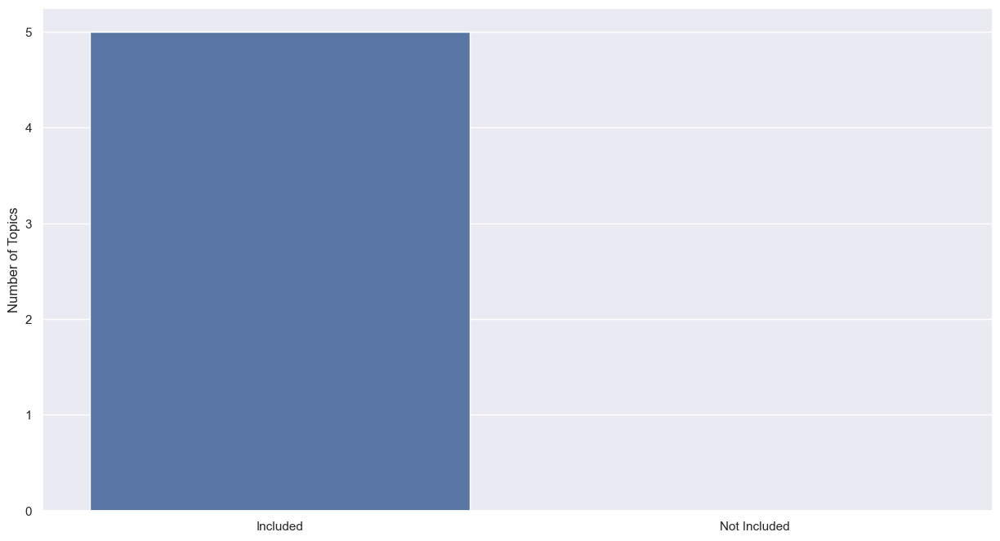

100.0% of Topics are included in Cluster Analysis:


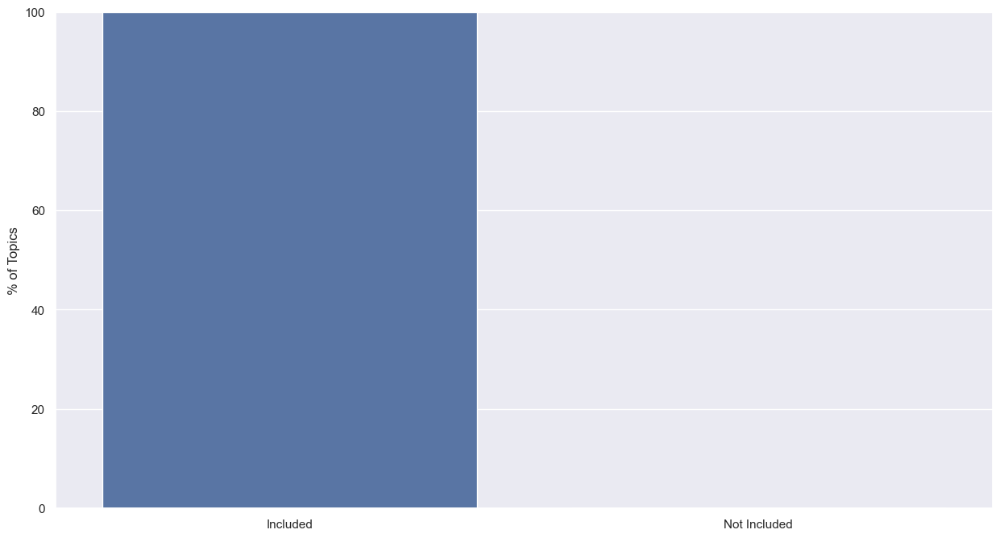

In [ ]:
cluster_eval.display_included_groups()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters per Topic:
----------------------------------------------------------------------------------------------------


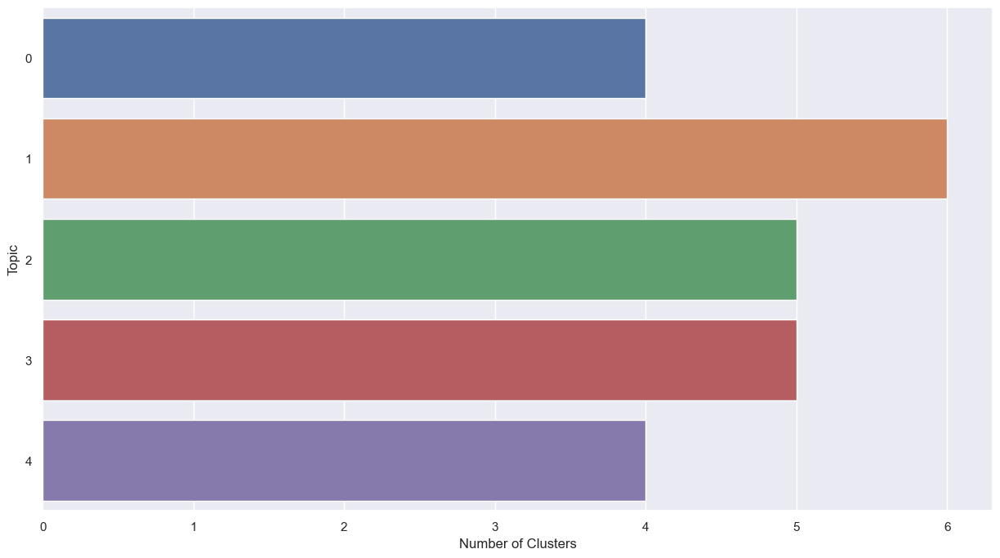

In [ ]:
cluster_eval.display_number_of_clusters_all_group()

In [ ]:
cluster_eval.print_number_of_clusters_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Clusters for each Topic:
----------------------------------------------------------------------------------------------------
Topic  Number of Clusters
    0                   4
    4                   4
    2                   5
    3                   5
    1                   6


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------


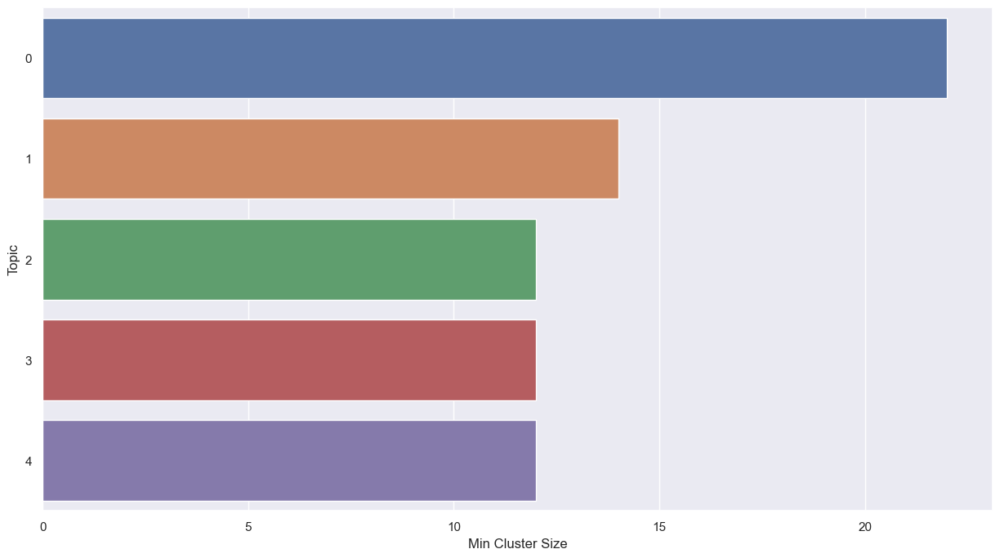

In [ ]:
cluster_eval.display_min_cluster_size_all_group()

In [ ]:
cluster_eval.print_min_cluster_sizes_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Min Cluster Size per Topic:
----------------------------------------------------------------------------------------------------
Topic  Min Cluster Size
    2                12
    3                12
    4                12
    1                14
    0                22


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------


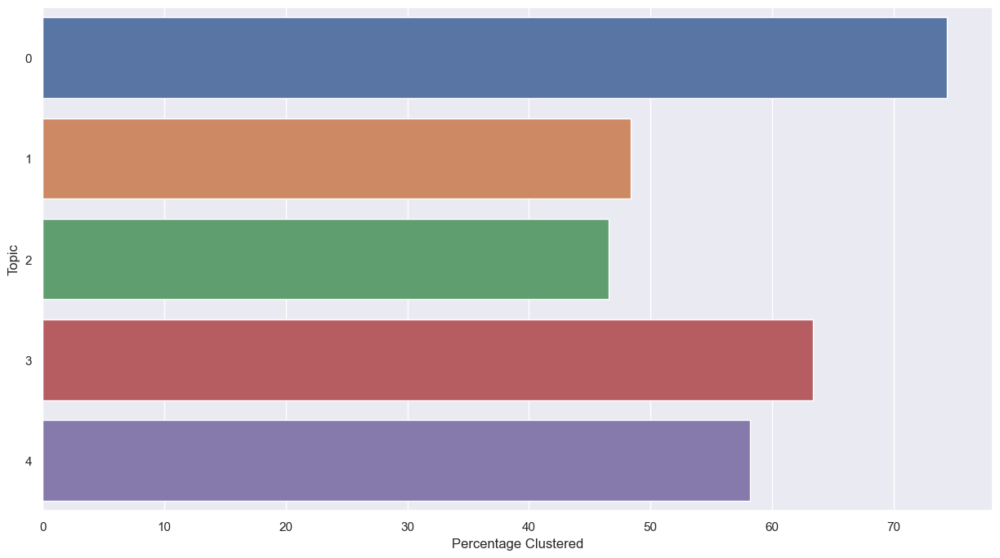

In [ ]:
cluster_eval.display_percentage_clustered_all_group()

In [ ]:
cluster_eval.print_percentage_clustered_all_group()

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Percentage Clustered per Topic:
----------------------------------------------------------------------------------------------------
Topic  Percentage Clustered
    2             46.558704
    1             48.380567
    4             58.158996
    3             63.319672
    0             74.400000


****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


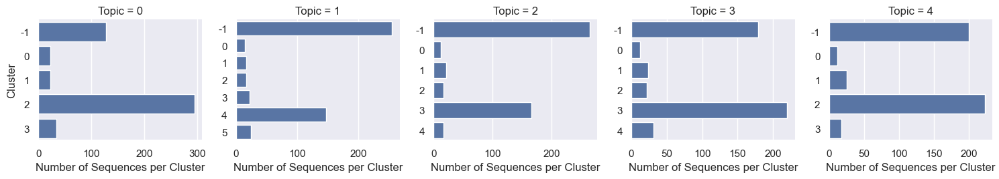

In [ ]:
cluster_eval.display_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


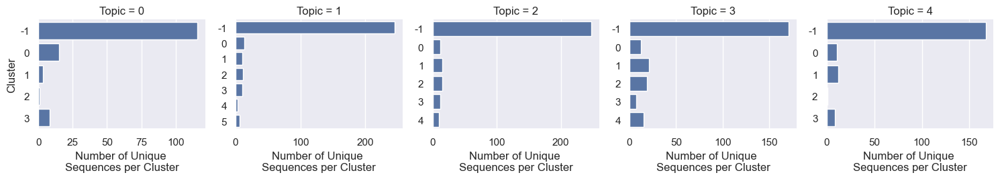

In [ ]:
cluster_eval.display_number_unique_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Number of Unique Sequences vs Number of Sequences per Cluster for each Topic:
----------------------------------------------------------------------------------------------------
Plots:


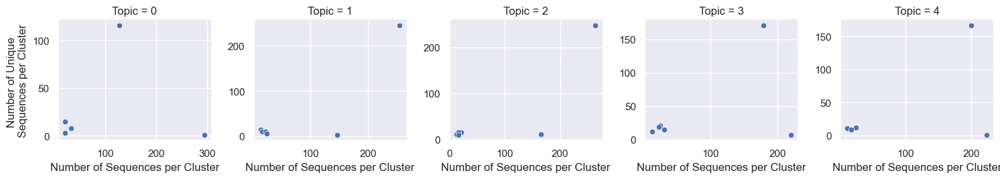

In [ ]:
cluster_eval.display_number_unique_sequences_vs_number_sequences_per_cluster_all_group(height=3)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Central Tendency Differences in Evaluation Metric between Clusters per Topic:
Chosen Evaluation Metric: "Topic Highest Score All Learning Resources Mean"
----------------------------------------------------------------------------------------------------


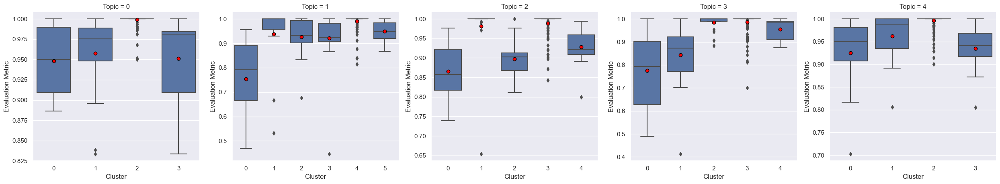

In [ ]:
cluster_eval.display_eval_metric_dist_between_cluster_all_groups(height=5)

****************************************************************************************************
****************************************************************************************************
 
----------------------------------------------------------------------------------------------------
Clusters per Topic
Dimensionality Reducer: UMAP
----------------------------------------------------------------------------------------------------


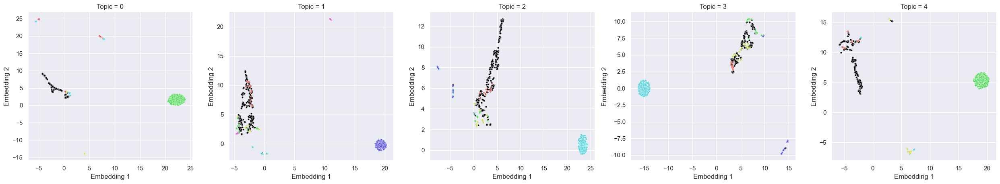

In [ ]:
cluster_eval.display_clusters_all_group_umap(height=5)